<a href="https://colab.research.google.com/github/YounSooKimTech/Joy_Profile_Photos/blob/main/Yale.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Meta Data

In [6]:
names_1 = []
urls_1 = []

import pandas as pd
import requests
from bs4 import BeautifulSoup

url = "https://som.yale.edu/faculty-research/faculty-directory"
response = requests.get(url)
#print(url, response)
soup = BeautifulSoup(response.content, 'html.parser')

div_tags = soup.find_all("div", class_="faculty-teaser-list-view__group")

for div_tag in div_tags:
  a_tags = div_tag.find_all("a")
  for a_tag in a_tags:
    name = a_tag.get_text().strip()
    href = a_tag["href"]
    url = f"https://som.yale.edu{href}"
    names_1.append(name)
    urls_1.append(url)
    #print(name, ":", url)

df_1 = pd.DataFrame({"Name":names_1,
                     "URL":urls_1})

df_1.head()

,Name,URL
0,Jason Abaluck,https://som.yale.edu/faculty-research/faculty-...
1,Laura Adler,https://som.yale.edu/faculty-research/faculty-...
2,Rick Antle,https://som.yale.edu/faculty-research/faculty-...
3,Jaime Arellano-Bover,https://som.yale.edu/faculty-research/faculty-...
4,David Argente,https://som.yale.edu/faculty-research/faculty-...


In [7]:
len(df_1)

236

In [9]:
import requests
from bs4 import BeautifulSoup

titles_1 = []

for index, row in df_1.iterrows():
    name = row["Name"]
    url = row["URL"]
    response = requests.get(url)
    soup = BeautifulSoup(response.content, 'html.parser')

    p_tag = soup.find("p", class_ = "node__job-title")
    title = p_tag.get_text().strip()

    titles_1.append(title)

    #print(name, ":", title)

df_1["Title"] = titles_1

## Filtering : exclude affiliated, lecturer, visiting, and meriti

In [33]:
df_SOM = df_1.head(105)
df_SOM.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 105 entries, 0 to 104
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   Name    105 non-null    object
 1   URL     105 non-null    object
 2   Title   105 non-null    object
dtypes: object(3)
memory usage: 2.6+ KB


In [34]:
df_SOM_prof = df_SOM[~df_SOM["Title"].str.contains("Lecturer|Visiting|Practice")]

df_SOM_prof.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 87 entries, 0 to 104
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   Name    87 non-null     object
 1   URL     87 non-null     object
 2   Title   87 non-null     object
dtypes: object(3)
memory usage: 2.7+ KB


## Biography

In [38]:
import requests
from bs4 import BeautifulSoup

bios_1 = []

for index, row in df_SOM_prof.iterrows():
    name = row["Name"]
    url = row["URL"]
    response = requests.get(url)
    soup = BeautifulSoup(response.content, 'html.parser')

    div_tag = soup.find("div", class_="text-long")
    bio_text = div_tag.get_text().strip()

    bios_1.append(bio_text)

    print(bio_text, "\n")

df_SOM_prof["Biography"] = bios_1

Professor Abaluck's work lies at the intersection of public finance, behavioral economics, health economics and industrial organization. His research focuses on the detection of mistakes and the design of institutions when consumers or providers make mistakes in contexts such as health plan choice, dietary choice, or the provision of medical care. 

Laura Adler's research examines topics at the intersection of organizations, gender, and cultural sociology with a focus on the future of work. Her recent research explores how the interaction between organizations and pay equity laws has shaped employers’ pay-setting practices. Using multiple methods including in-depth interviews, archival research, and survey experiments, this project provides insight into pay-setting as an organizational practice and site for the reproduction of inequality.
Other projects explore the world of work from the perspectives of workers, employers, and regulatory authorities. One paper explains why highly educa

<ipython-input-38-f77ed79641d9>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_SOM_prof["Biography"] = bios_1


## Extract Sex information from Biography

In [39]:
import spacy
nlp = spacy.load('en_core_web_sm')

pronouns_list = []

for text in df_SOM_prof['Biography']:
    if text == None:
      text = ""
    doc = nlp(text)
    pronouns = [token.text.lower() for token in doc if token.pos_ == 'PRON' and token.text.lower() in ['he', 'she', 'her', 'his']]
    pronouns_list.append(pronouns)

df_SOM_prof['Pronouns'] = pronouns_list

def determine_sex(pronouns):
    if 'he' in pronouns or 'his' in pronouns:
        return 'Male'
    elif 'she' in pronouns or 'her' in pronouns:
        return 'Female'
    else:
        return 'Unknown'

df_SOM_prof['Sex'] = df_SOM_prof['Pronouns'].apply(determine_sex)

<ipython-input-39-4e6dfda9fd87>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_SOM_prof['Pronouns'] = pronouns_list
<ipython-input-39-4e6dfda9fd87>:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_SOM_prof['Sex'] = df_SOM_prof['Pronouns'].apply(determine_sex)


In [40]:
df_SOM_prof["Sex"].value_counts()

Male       60
Female     23
Unknown     4
Name: Sex, dtype: int64

In [41]:
df_SOM_prof[df_SOM_prof["Sex"] == "Unknown"]

,Name,URL,Title,Biography,Pronouns,Sex
23,Jason Dana,https://som.yale.edu/faculty-research/faculty-...,Associate Professor of Management and Marketing,Jason Dana’s research focuses on how people ma...,[],Unknown
37,Soheil Ghili,https://som.yale.edu/faculty-research/faculty-...,Assistant Professor of Marketing,I am an assistant professor of Marketing at Ya...,[],Unknown
52,Joowon Klusowski,https://som.yale.edu/faculty-research/faculty-...,Assistant Professor of Marketing,Professor Joowon Klusowski studies how people ...,[],Unknown
74,Nils Rudi,https://som.yale.edu/faculty-research/faculty-...,Professor of Operations Management,"Education\nPhD, The Wharton School, University...",[],Unknown


In [42]:
# https://cbey.yale.edu/our-community/jason-dana
# https://fds.yale.edu/soheil-ghili/
# https://law.yale.edu/nils-rudi

df_SOM_prof.loc[df_SOM_prof["Name"] == "Jason Dana", "Sex"] = "Male"
df_SOM_prof.loc[df_SOM_prof["Name"] == "Soheil Ghili", "Sex"] = "Male"
df_SOM_prof.loc[df_SOM_prof["Name"] == "Nils Rudi", "Sex"] = "Male"


<ipython-input-42-dc406dd42505>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_SOM_prof.loc[df_SOM_prof["Name"] == "Jason Dana", "Sex"] = "Male"
<ipython-input-42-dc406dd42505>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_SOM_prof.loc[df_SOM_prof["Name"] == "Soheil Ghili", "Sex"] = "Male"
<ipython-input-42-dc406dd42505>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_SOM_prof.loc[df_SOM_prof["Name"] == "Nils Rudi", "Sex

In [43]:
df_SOM_prof[df_SOM_prof["Sex"] == "Unknown"]

,Name,URL,Title,Biography,Pronouns,Sex
52,Joowon Klusowski,https://som.yale.edu/faculty-research/faculty-...,Assistant Professor of Marketing,Professor Joowon Klusowski studies how people ...,[],Unknown


## Rank

In [44]:
import numpy as np

conditions = [
    df_SOM_prof["Title"].str.contains("Emeritus"),
    df_SOM_prof["Title"].str.contains("Emerita"),
    df_SOM_prof["Title"].str.contains("Assistant"),
    df_SOM_prof["Title"].str.contains("Associate")
]

choices = ["Emeritus", "Emeritus", "Assistant", "Associate"]

df_SOM_prof["Rank"] = np.select(conditions, choices, default="Full")

df_SOM_prof["Rank"].value_counts()

<ipython-input-44-b0d3f1f0795b>:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_SOM_prof["Rank"] = np.select(conditions, choices, default="Full")


Full         46
Assistant    29
Associate    12
Name: Rank, dtype: int64

In [45]:
df_SOM_prof[["Rank", "Title"]]

,Rank,Title
0,Full,Professor of Economics
1,Assistant,Assistant Professor of Organizational Behavior
2,Full,William S. Beinecke Professor of Accounting
4,Assistant,Assistant Professor of Economics
5,Full,Stephen and Camille Schramm Professor of Finance
...,...,...
100,Full,"Joseph F. Cullman, 3rd Professor of Marketing"
101,Assistant,Assistant Professor of Finance
102,Full,Professor of Accounting
103,Full,Professor of Economics


In [152]:
# Department

df_SOM_prof["Department"] = df_SOM_prof["Title"].str.split("of").str[-1]

x = 80
df_SOM_prof.iloc[x:x+10, :]

<ipython-input-152-130f937a1ced>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_SOM_prof["Department"] = df_SOM_prof["Title"].str.split("of").str[-1]


,Name,URL,Title,Biography,Pronouns,Sex,Rank,Department
98,Kai Hao Yang,https://som.yale.edu/faculty-research/faculty-...,Assistant Professor of Economics,Using the tools of mechanism design and inform...,[he],Male,Assistant,Economics
99,Tauhid Zaman,https://som.yale.edu/faculty-research/faculty-...,Associate Professor of Operations Management,Tauhid is an Associate Professor of Operations...,"[he, his, his, he, his, his]",Male,Associate,Operations Management
100,Gal Zauberman,https://som.yale.edu/faculty-research/faculty-...,"Joseph F. Cullman, 3rd Professor of Marketing",Professor Gal Zauberman studies human judgment...,"[his, he, he, he, his]",Male,Full,Marketing
101,Alexander Zentefis,https://som.yale.edu/faculty-research/faculty-...,Assistant Professor of Finance,Professor Zentefis researches the structure of...,"[his, he]",Male,Assistant,Finance
102,X. Frank Zhang,https://som.yale.edu/faculty-research/faculty-...,Professor of Accounting,Professor Zhang's research focuses on empirica...,[he],Male,Full,Accounting
103,Jidong Zhou,https://som.yale.edu/faculty-research/faculty-...,Professor of Economics,Professor Zhou's research fields include appli...,"[his, he, his, he]",Male,Full,Economics
104,Seth Zimmerman,https://som.yale.edu/faculty-research/faculty-...,Professor of Economics,Professor Zimmerman studies labor economics an...,[his],Male,Full,Economics


In [156]:
df_SOM_prof.loc[df_SOM_prof["Name"] =="Lorenzo Caliendo", "Department"] = "Economics"
df_SOM_prof.loc[df_SOM_prof["Name"] =="Kerwin K. Charles", "Department"] = "Economics"

df_SOM_prof.loc[df_SOM_prof["Name"] =="Ravi Dhar", "Department"] = "Management and Marketing"
df_SOM_prof.loc[df_SOM_prof["Name"] =="William N. Goetzmann", "Department"] = "Finance and Management"

df_SOM_prof.loc[df_SOM_prof["Name"] =="Robert T. Jensen", "Department"] = "Economics"
df_SOM_prof.loc[df_SOM_prof["Name"] =="Bryan T. Kelly", "Department"] = "Finance"

df_SOM_prof.loc[df_SOM_prof["Name"] =="K. Geert Rouwenhorst", "Department"] = "Finance"
df_SOM_prof.loc[df_SOM_prof["Name"] =="K. Sudhir", "Department"] = "Marketing"

df_SOM_prof["Department"] = df_SOM_prof["Department"].str.replace("&", "and")
df_SOM_prof["Department"] = df_SOM_prof["Department"].str.strip()

<ipython-input-156-daa39812bef7>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_SOM_prof["Department"] = df_SOM_prof["Department"].str.replace("&", "and")
<ipython-input-156-daa39812bef7>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_SOM_prof["Department"] = df_SOM_prof["Department"].str.strip()


In [157]:
df_SOM_prof["Department"].value_counts()

Finance                     18
Economics                   14
Marketing                   14
Organizational Behavior      9
Accounting                   7
Operations Management        6
Economics and Management     4
Management                   3
Finance and Management       2
Management and Marketing     2
Management and Finance       1
Public Health                1
Finance and Economics        1
Operations                   1
Management and Economics     1
Operations Research          1
International Economics      1
Accounting and Finance       1
Name: Department, dtype: int64

# Get the image

In [107]:
from google.colab import files
import requests
from bs4 import BeautifulSoup

for index, row in df_SOM_prof.iterrows():
    name = row["Name"]
    new_name = name.lower().replace(".", "").replace(" ", "_")
    filename = f"{new_name}.jpg"

    url = row["URL"]
    response = requests.get(url)
    soup = BeautifulSoup(response.content, 'html.parser')

    div_tag = soup.find("div", class_="node__header-image")
    img_tag = div_tag.find("img")
    img_srcset = img_tag.get("srcset", None)

    if img_srcset is None:
        img_srcset = img_tag.get("data-src", None)
        img_src = img_srcset

    if img_srcset:
        # Split the srcset by space and get the first element
        img_src = img_srcset.split(",")[-1].strip()
        img_src = img_src.replace("1021w", "").strip()

        if "160" in img_src:
          img_src = img_tag.get("data-src")
          img_src = img_src.replace("square_160", "card_800_")


    img_url = f"https://som.yale.edu{img_src}"

    #print(name, img_url, "\n")
    flag = requests.get(img_url)

    with open(filename, "wb") as f:
        noop = f.write(flag.content)
        print(f"{name} saved the {filename}")

        files.download(filename)
        #print(f"download the {filename}")


Jason Abaluck saved the jason_abaluck.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Laura Adler saved the laura_adler.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Rick Antle saved the rick_antle.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

David Argente saved the david_argente.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Nicholas C. Barberis saved the nicholas_c_barberis.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

James N. Baron saved the james_n_baron.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Barbara Biasi saved the barbara_biasi.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Tristan L. Botelho saved the tristan_l_botelho.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Alex Burnap saved the alex_burnap.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Lorenzo Caliendo saved the lorenzo_caliendo.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Kerwin K. Charles saved the kerwin_k_charles.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Judith A. Chevalier saved the judith_a_chevalier.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

James Choi saved the james_choi.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Christopher Clayton saved the christopher_clayton.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Corey Cusimano saved the corey_cusimano.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Jason Dana saved the jason_dana.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Jennifer Dannals saved the jennifer_dannals.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Ravi Dhar saved the ravi_dhar.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Julia DiBenigno saved the julia_dibenigno.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Kevin Donovan saved the kevin_donovan.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Raphael Duguay saved the raphael_duguay.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Jonathan S. Feinstein saved the jonathan_s_feinstein.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Paul Fontanier saved the paul_fontanier.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Shane Frederick saved the shane_frederick.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Adriana Germano saved the adriana_germano.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Soheil Ghili saved the soheil_ghili.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Stefano Giglio saved the stefano_giglio.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

William N. Goetzmann saved the william_n_goetzmann.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Paul Goldsmith-Pinkham saved the paul_goldsmith-pinkham.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Gary B. Gorton saved the gary_b_gorton.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Menaka V. Hampole saved the menaka_v_hampole.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Zeqiong Huang saved the zeqiong_huang.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Theis Ingerslev Jensen saved the theis_ingerslev_jensen.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Robert T. Jensen saved the robert_t_jensen.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Edward H. Kaplan saved the edward_h_kaplan.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Ivana V. Katic saved the ivana_v_katic.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Bryan T. Kelly saved the bryan_t_kelly.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Sang Kim saved the sang_kim.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Joowon Klusowski saved the joowon_klusowski.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Balázs Kovács saved the balázs_kovács.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Vineet Kumar saved the vineet_kumar.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Cameron LaPoint saved the cameron_lapoint.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

James A. Levinsohn saved the james_a_levinsohn.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Zhen Lian saved the zhen_lian.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Song Ma saved the song_ma.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Vahideh Manshadi saved the vahideh_manshadi.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Lesley Meng saved the lesley_meng.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Andrew Metrick saved the andrew_metrick.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Ahmed Mushfiq Mobarak saved the ahmed_mushfiq_mobarak.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Faidra Monachou saved the faidra_monachou.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Tobias J. Moskowitz saved the tobias_j_moskowitz.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

David M. Munguia Gomez saved the david_m_munguia_gomez.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Anya Nakhmurina saved the anya_nakhmurina.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Barry Nalebuff saved the barry_nalebuff.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Nathan Novemsky saved the nathan_novemsky.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Jayanti Owens saved the jayanti_owens.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Edieal J. Pinker saved the edieal_j_pinker.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Benjamin Polak saved the benjamin_polak.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Taly Reich saved the taly_reich.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

K. Geert Rouwenhorst saved the k_geert_rouwenhorst.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Nils Rudi saved the nils_rudi.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Peter K. Schott saved the peter_k_schott.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Fiona M. Scott Morton saved the fiona_m_scott_morton.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Katja Seim saved the katja_seim.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Jiwoong Shin saved the jiwoong_shin.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Kelly Shue saved the kelly_shue.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Alp Simsek saved the alp_simsek.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Michael Sinkinson saved the michael_sinkinson.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Deborah Small saved the deborah_small.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Edward A. Snyder saved the edward_a_snyder.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Matthew Spiegel saved the matthew_spiegel.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Thomas Steffen saved the thomas_steffen.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

K. Sudhir saved the k_sudhir.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Jacob Thomas saved the jacob_thomas.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Heather E. Tookes saved the heather_e_tookes.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Kosuke Uetake saved the kosuke_uetake.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Diana Van Patten saved the diana_van_patten.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Tong Wang saved the tong_wang.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Edward Watts saved the edward_watts.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Kevin R. Williams saved the kevin_r_williams.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Kai Hao Yang saved the kai_hao_yang.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Tauhid Zaman saved the tauhid_zaman.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Gal Zauberman saved the gal_zauberman.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Alexander Zentefis saved the alexander_zentefis.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

X. Frank Zhang saved the x_frank_zhang.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Jidong Zhou saved the jidong_zhou.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Seth Zimmerman saved the seth_zimmerman.jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# Smile Detection

In [117]:
df_SOM_prof["Name"] = df_SOM_prof["Name"].str.strip()

df_SOM_prof[df_SOM_prof["Name"].str.contains("Germano")]

<ipython-input-117-5a122ac55546>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_SOM_prof["Name"] = df_SOM_prof["Name"].str.strip()


,Name,URL,Title,Biography,Pronouns,Sex,Rank
36,Adriana Germano,https://som.yale.edu/faculty-research/faculty-...,Assistant Professor of Organizational Behavior,Adriana Germano investigates the cultural foun...,"[she, her, her, her]",Female,Assistant


Jason Abaluck


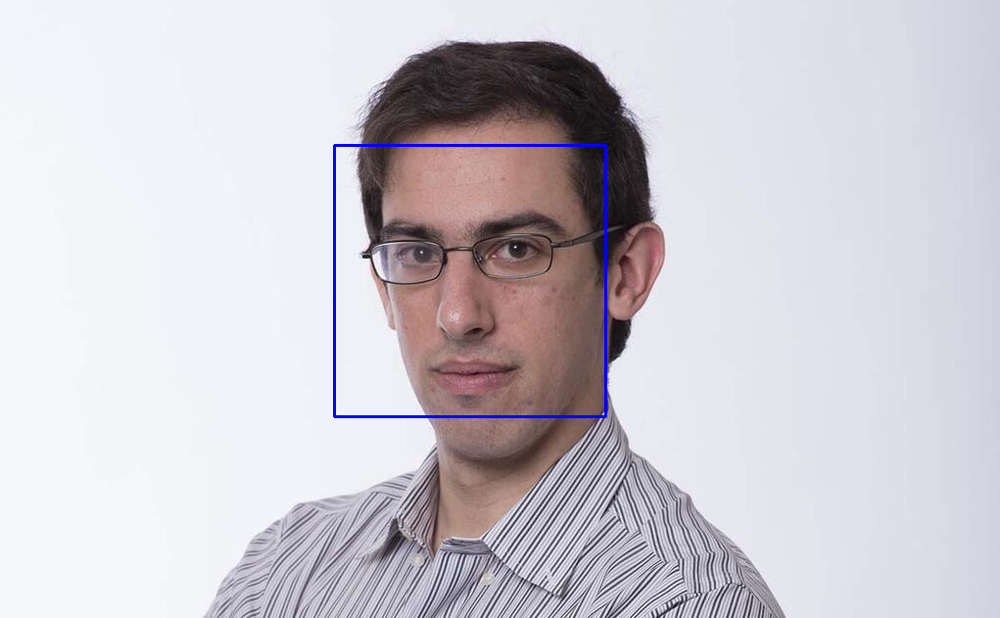

Laura Adler


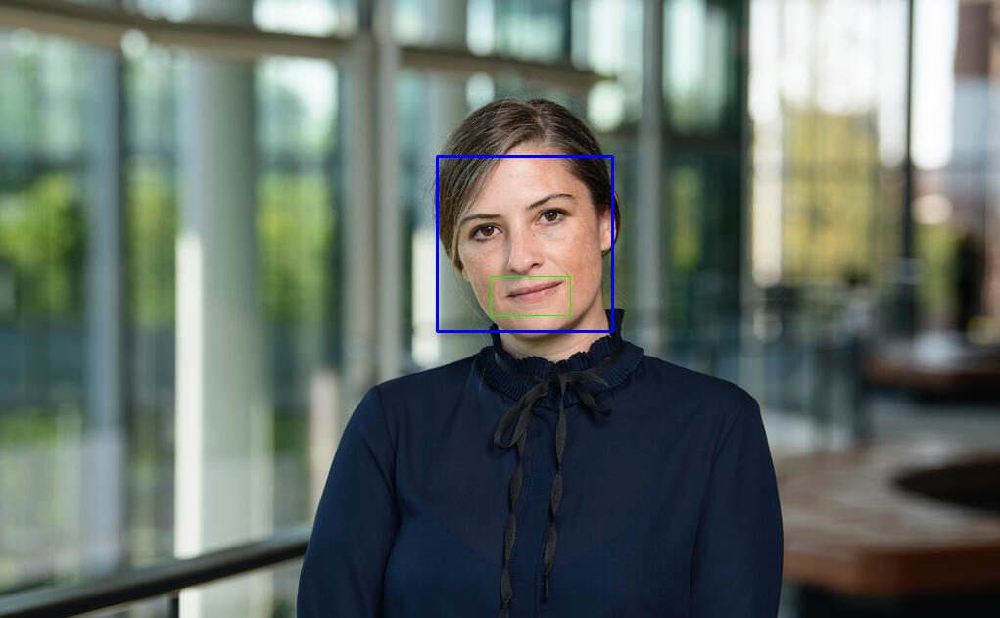

Rick Antle


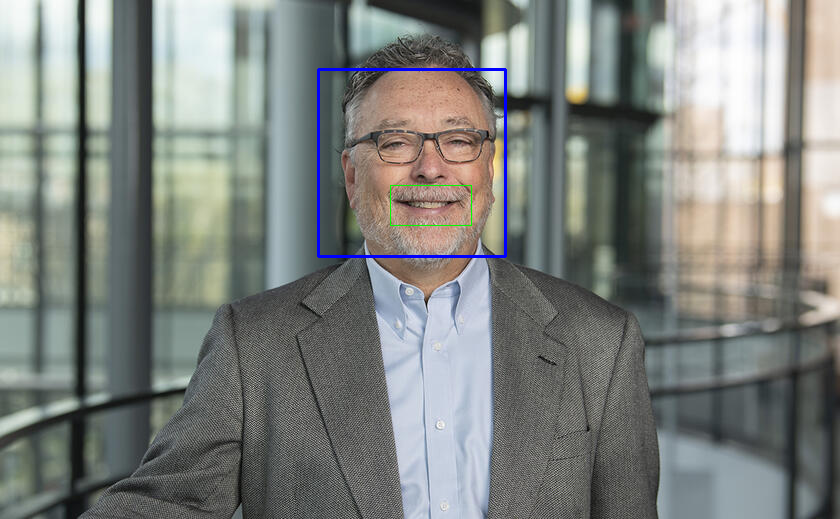

David Argente


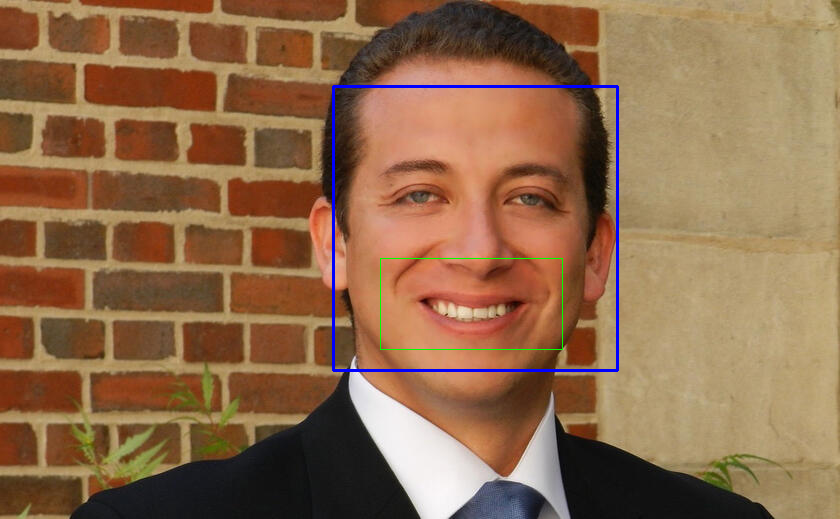

Nicholas C. Barberis


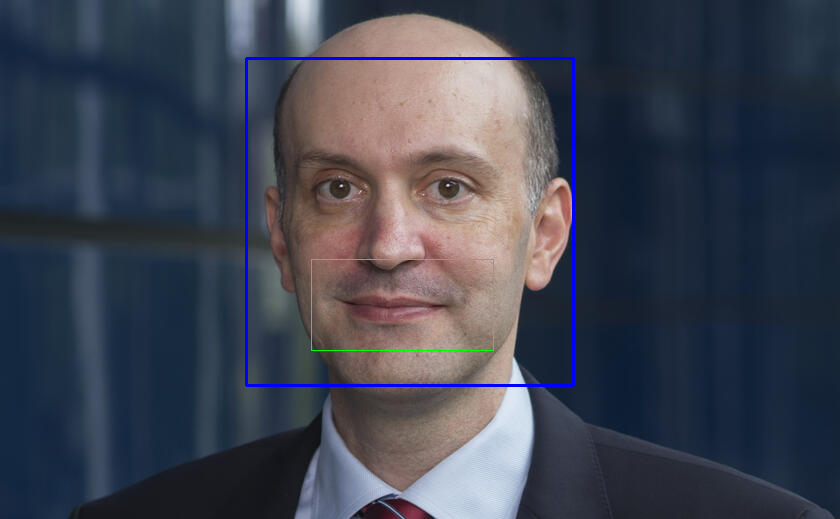

James N. Baron


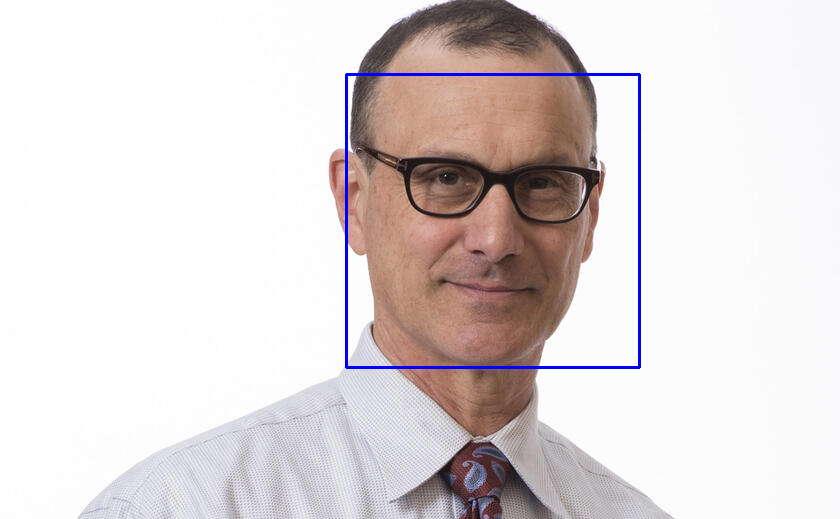

Barbara Biasi


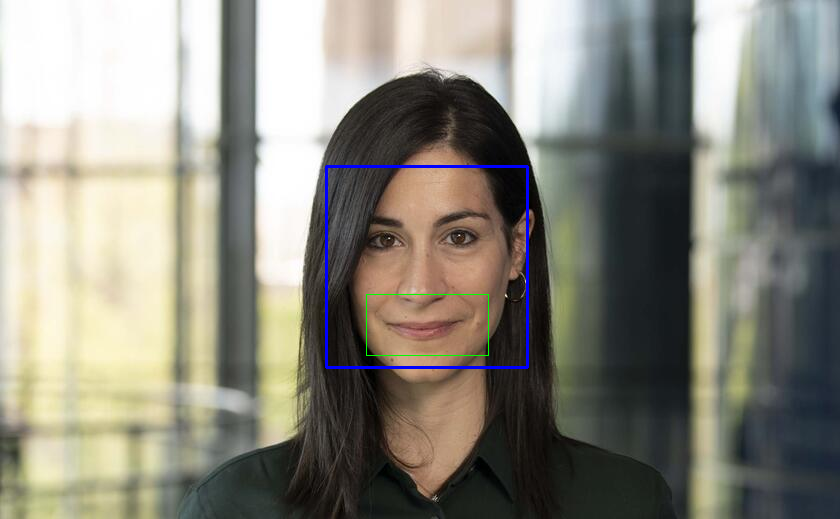

Tristan L. Botelho


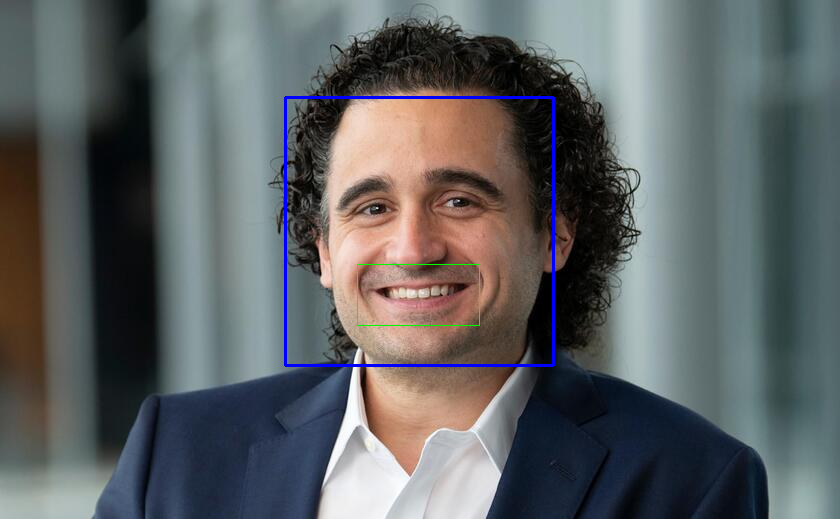

Alex Burnap


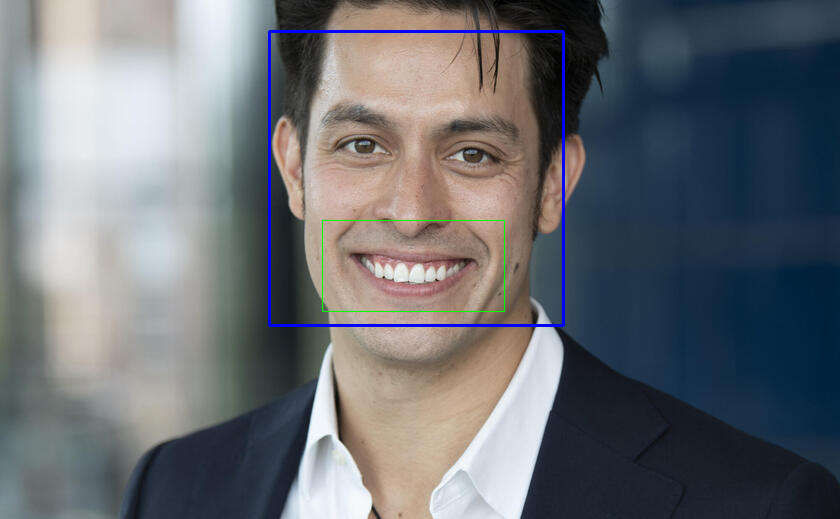

Lorenzo Caliendo


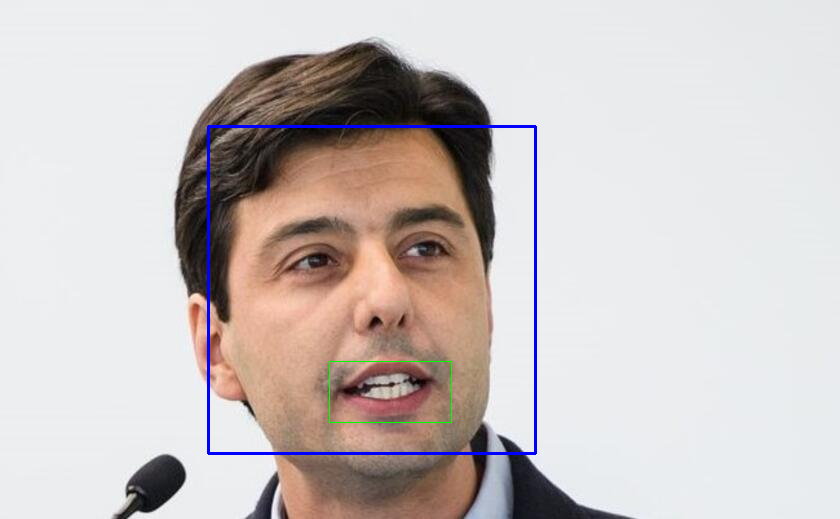

Kerwin K. Charles


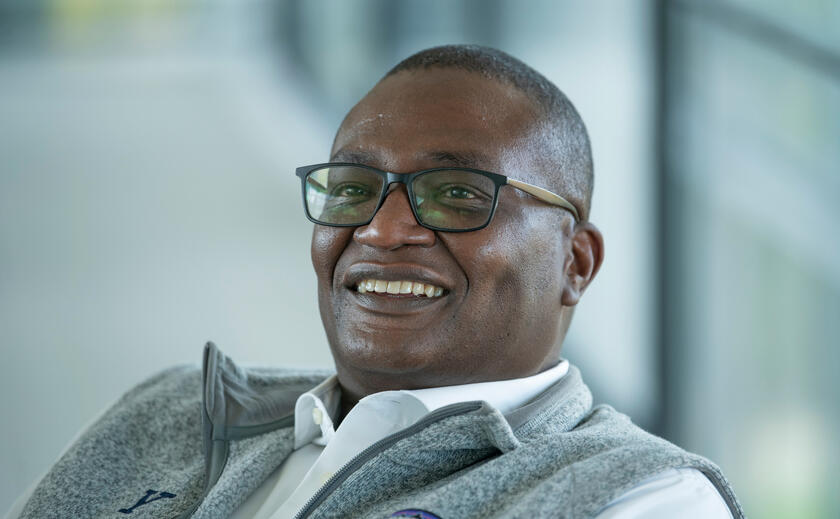

Judith A. Chevalier


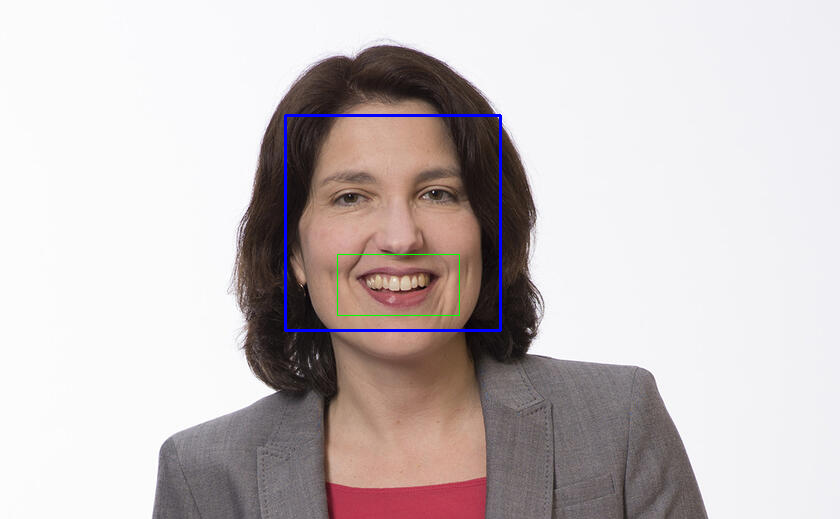

James Choi


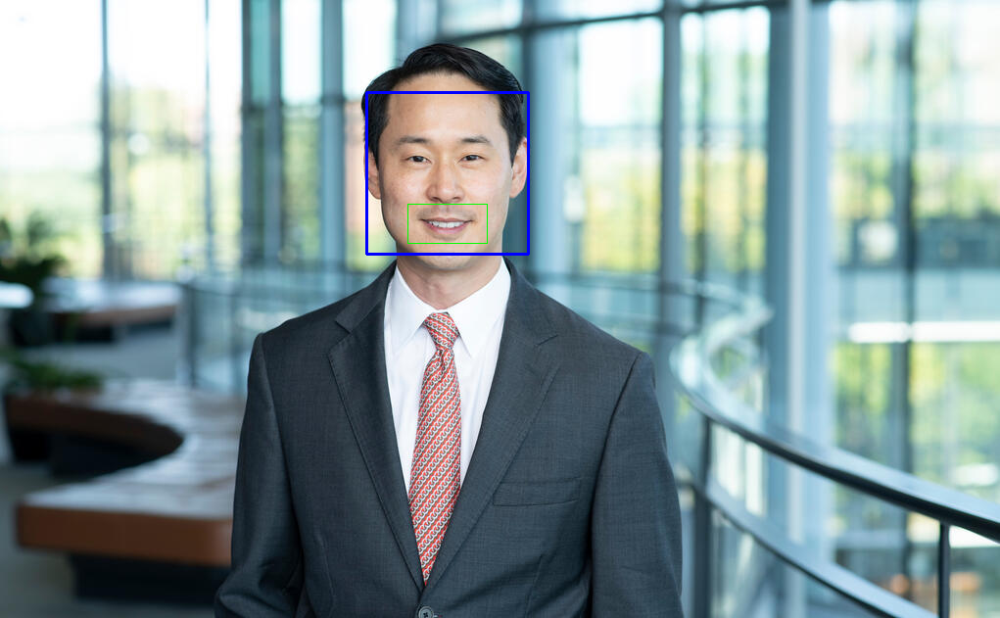

Christopher Clayton


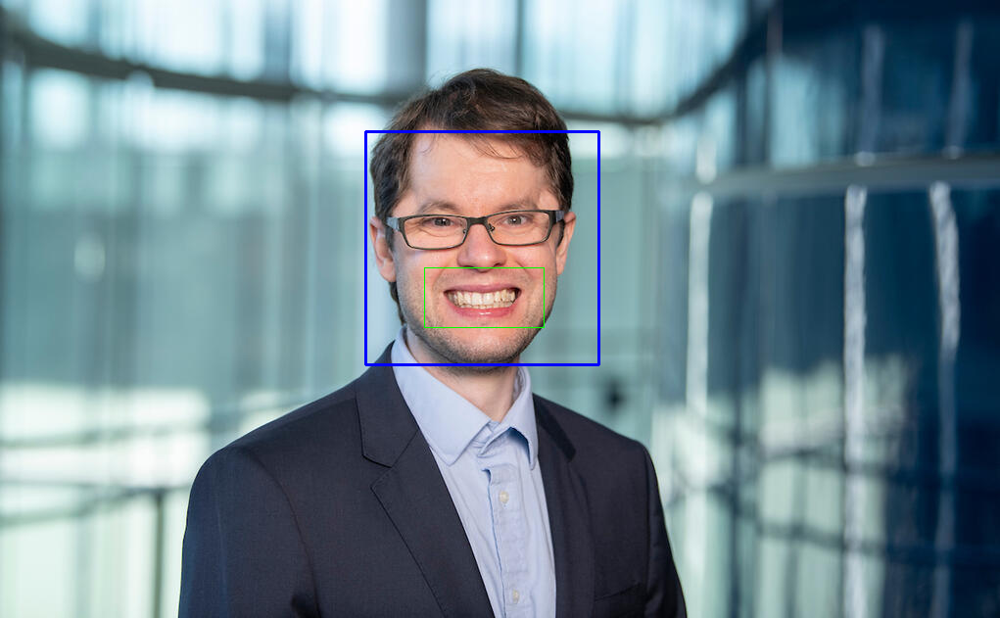

Corey Cusimano


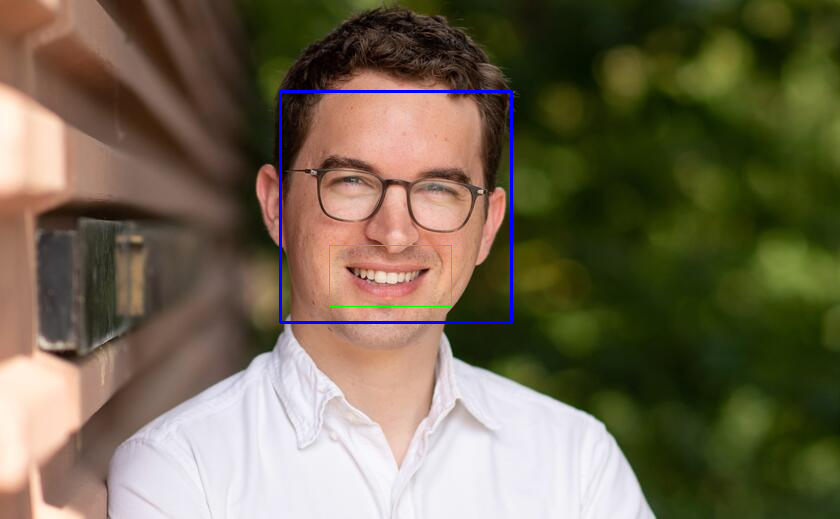

Jason Dana


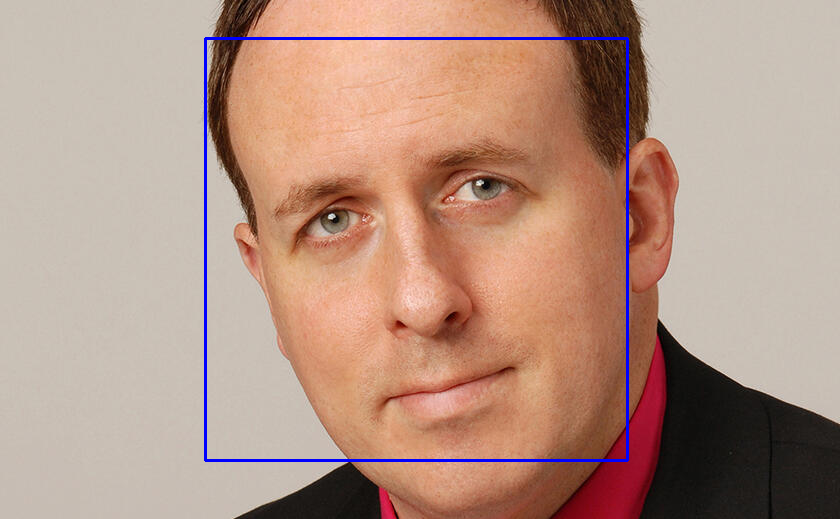

Jennifer Dannals


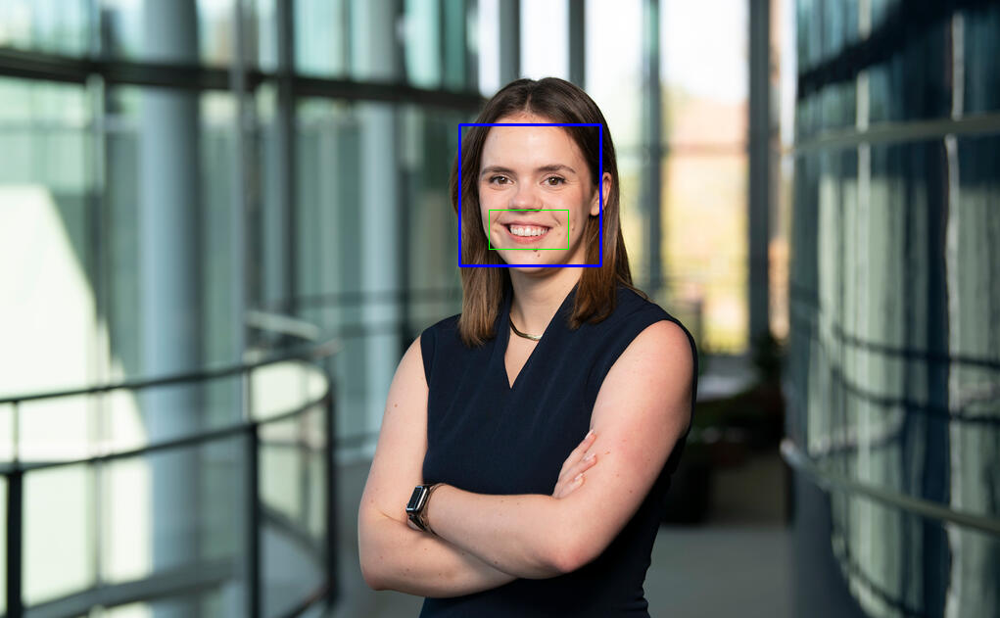

Ravi Dhar


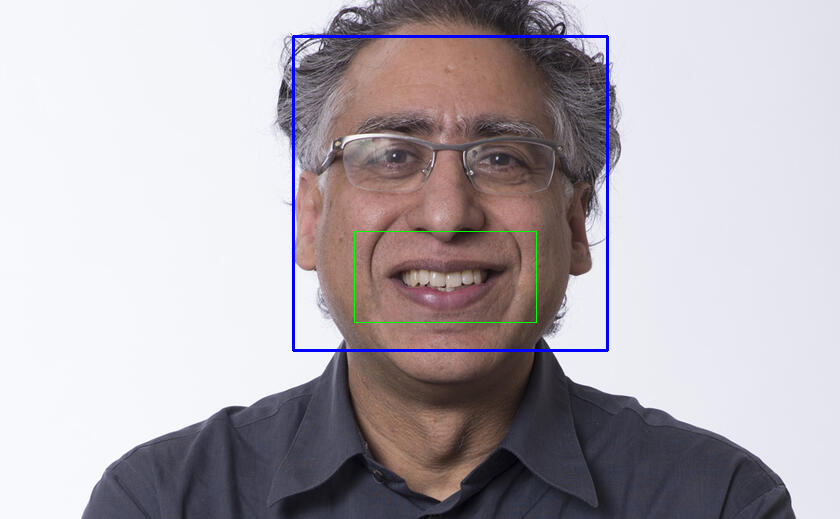

Julia DiBenigno


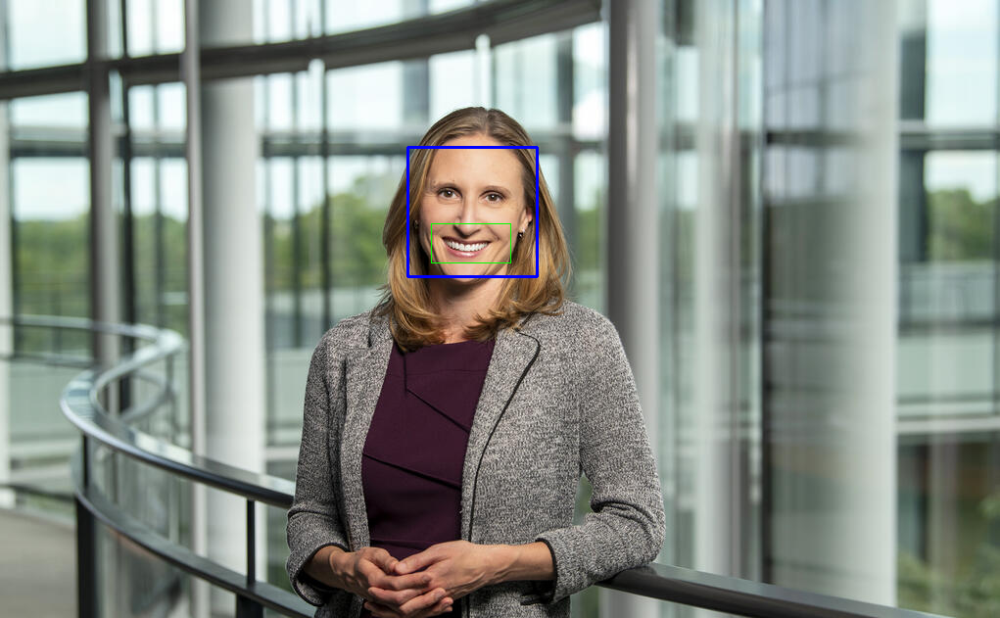

Kevin Donovan


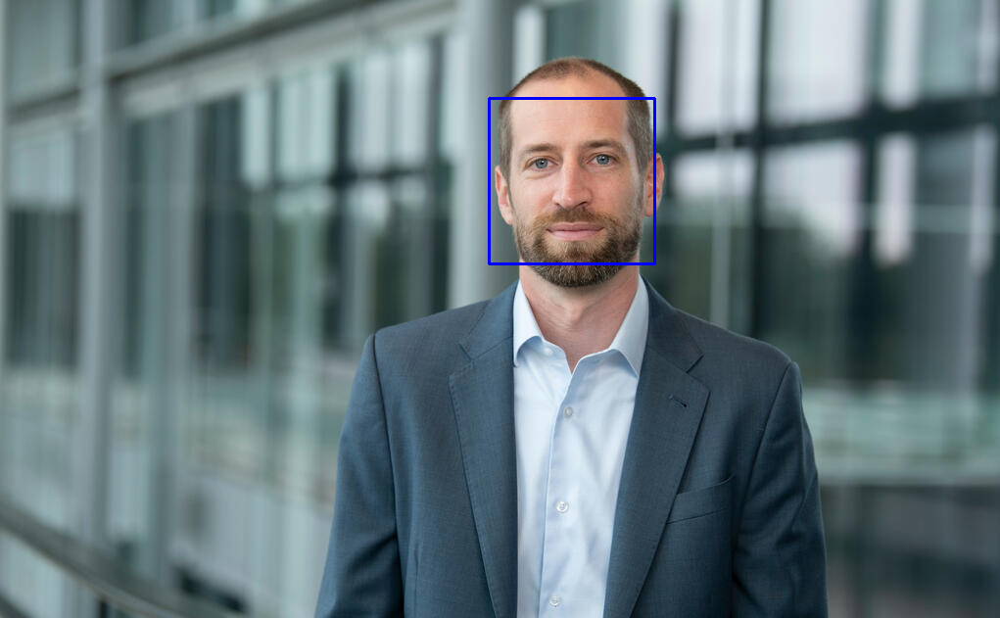

Raphael Duguay


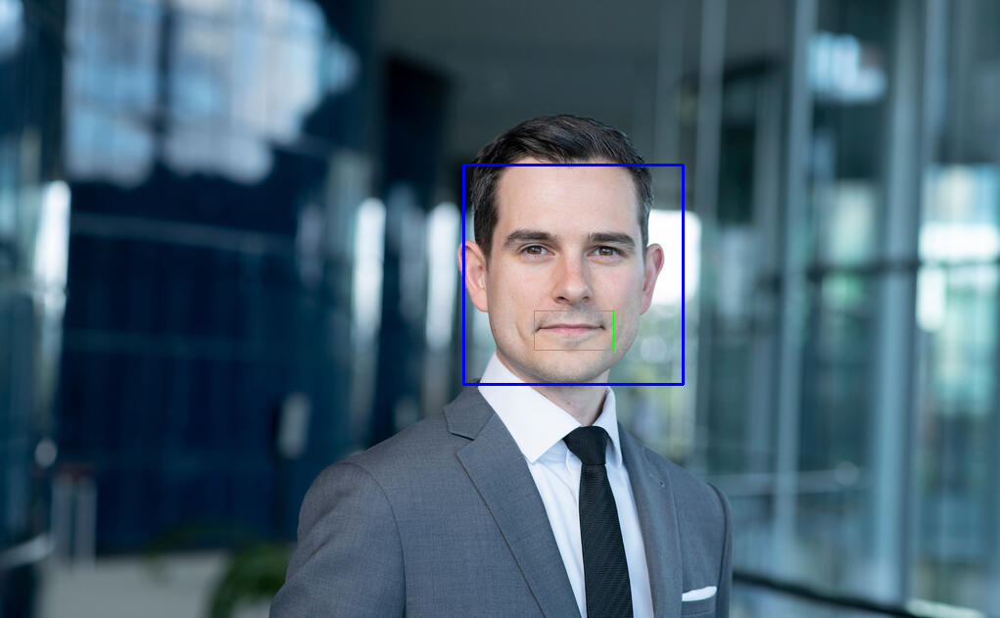

Jonathan S. Feinstein


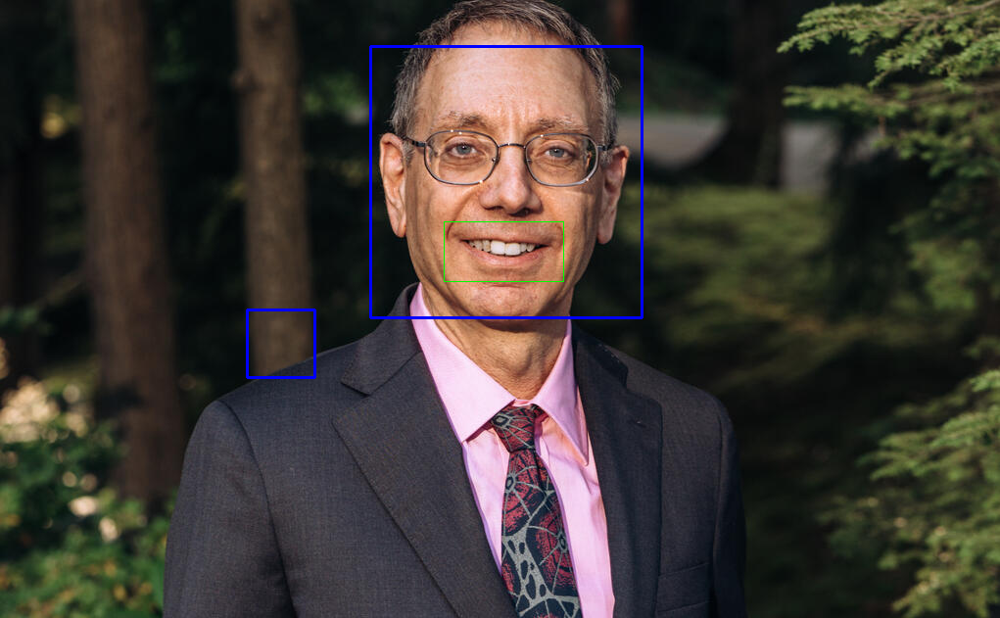

Paul Fontanier


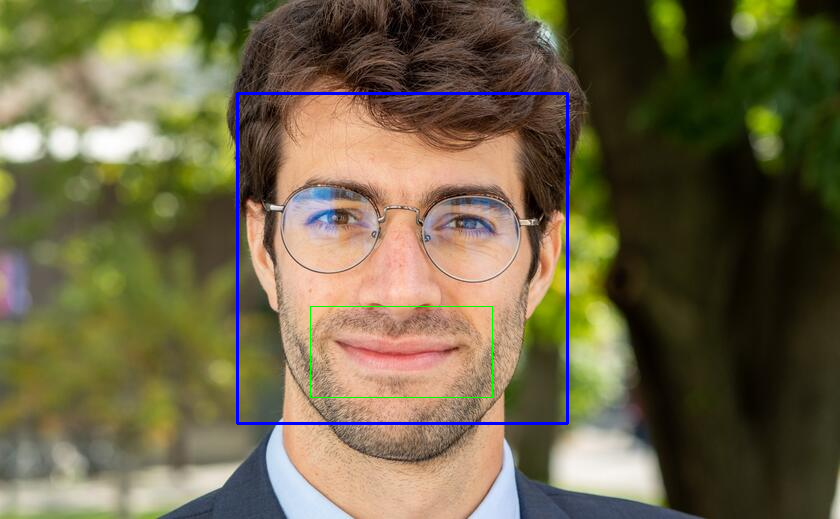

Shane Frederick


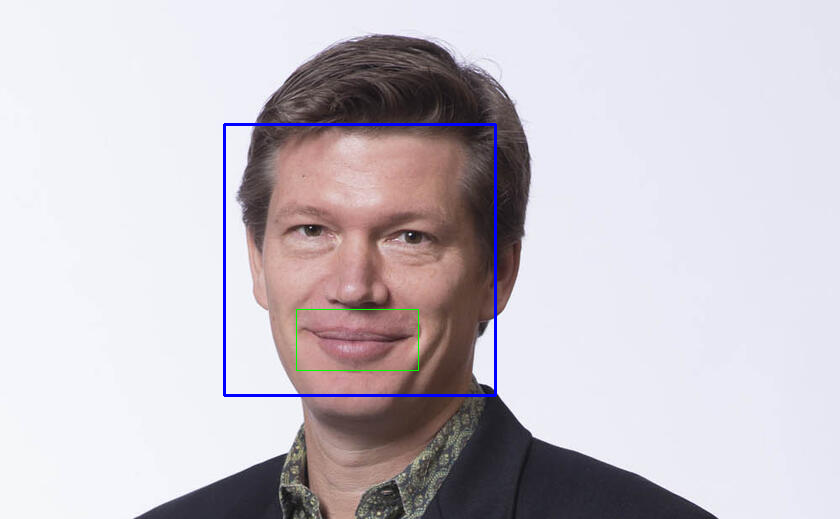

Adriana Germano


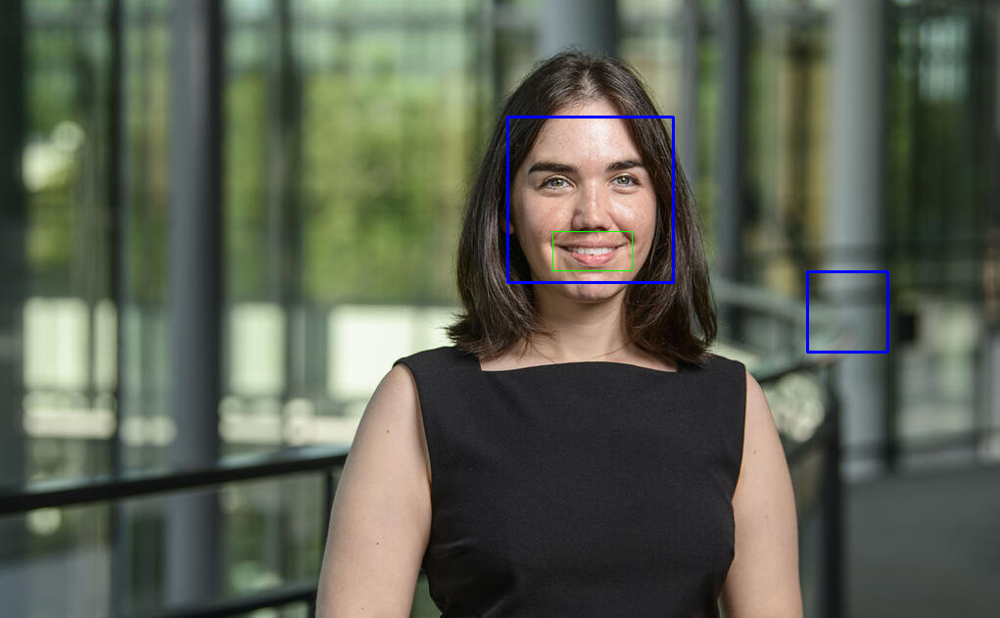

Soheil Ghili


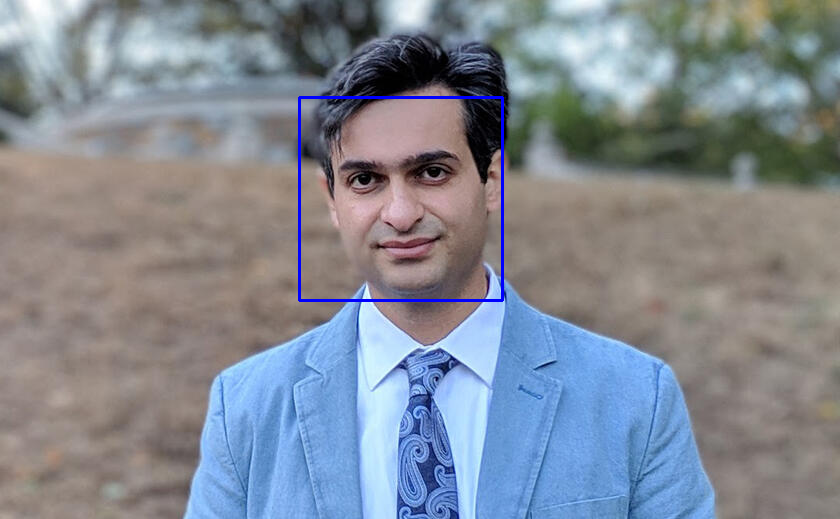

Stefano Giglio


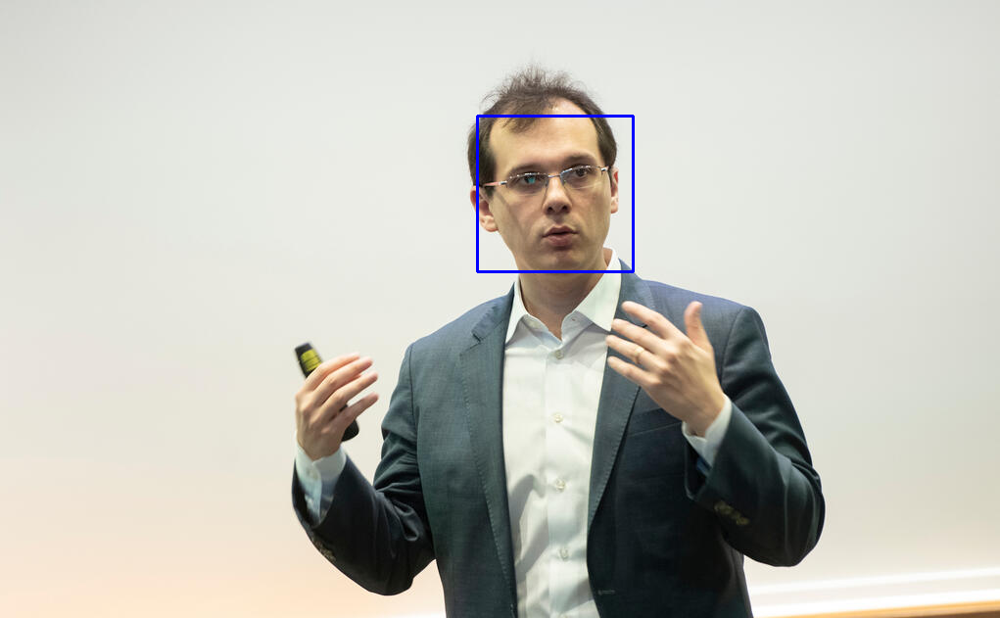

William N. Goetzmann


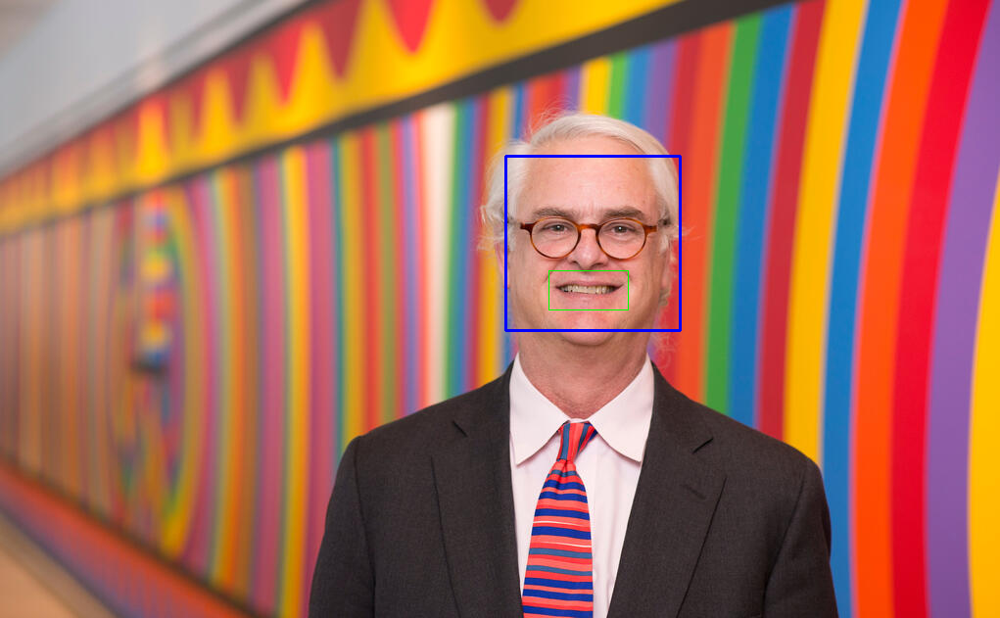

Paul Goldsmith-Pinkham


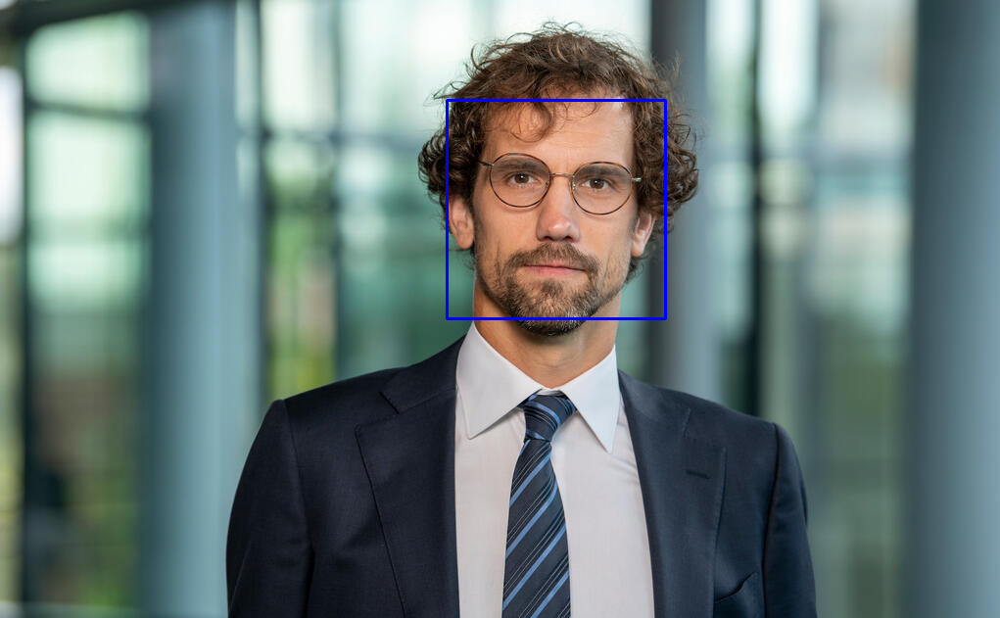

Gary B. Gorton


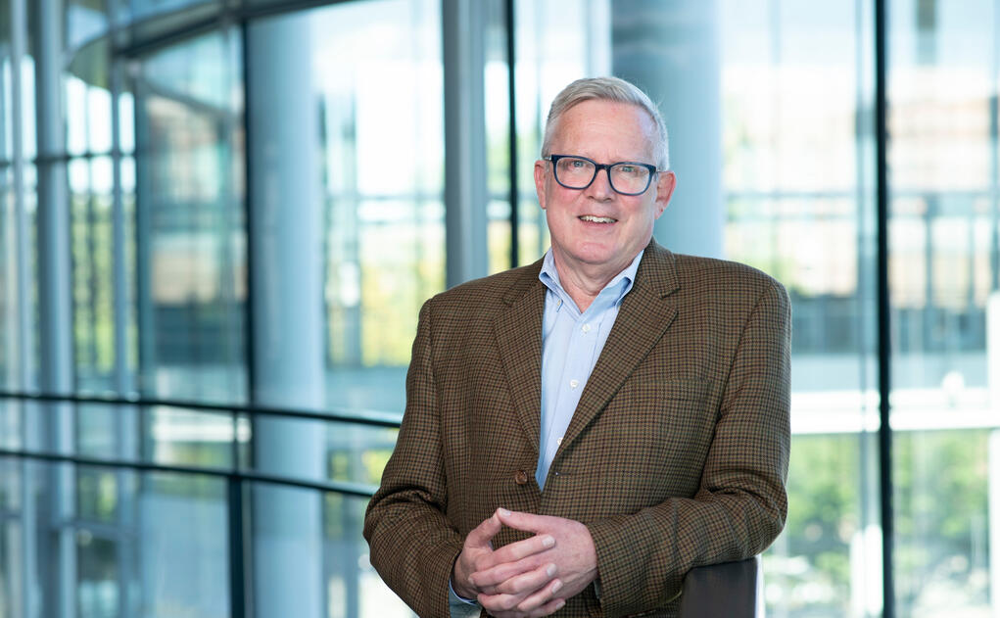

Menaka V. Hampole


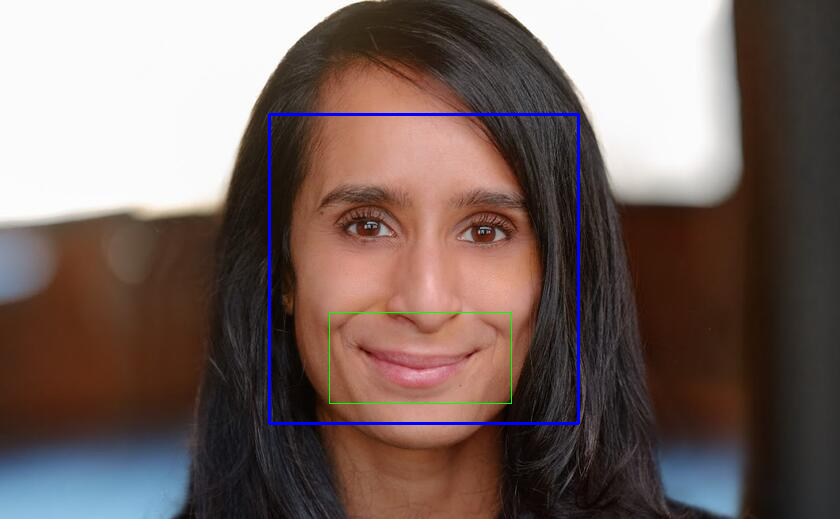

Zeqiong Huang


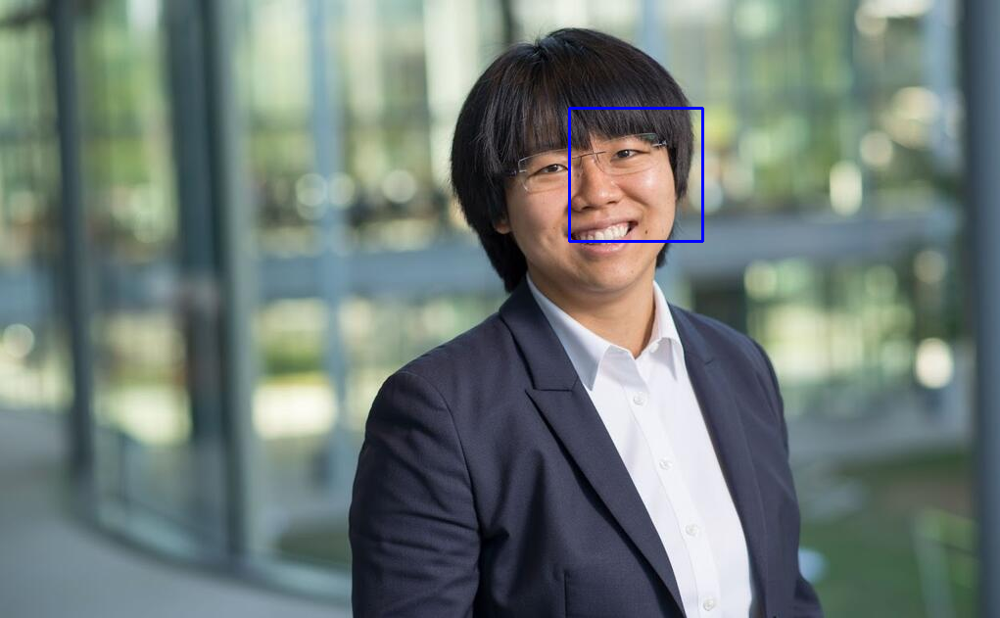

Theis Ingerslev Jensen


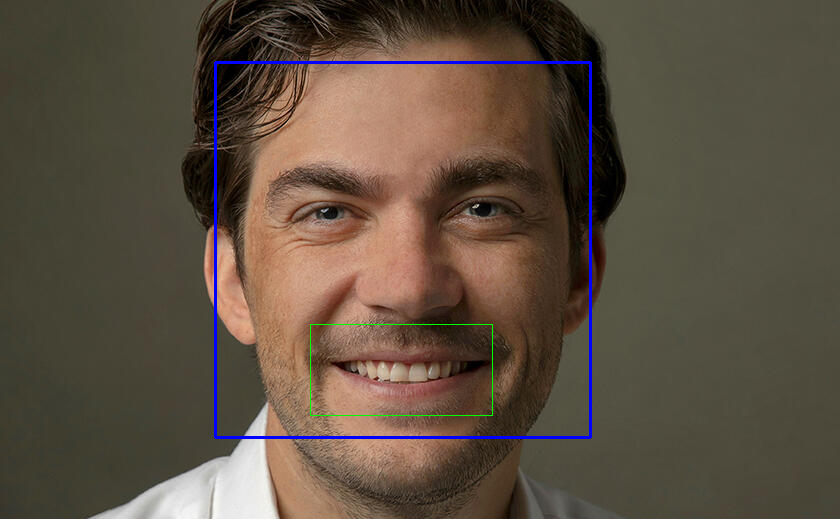

Robert T. Jensen


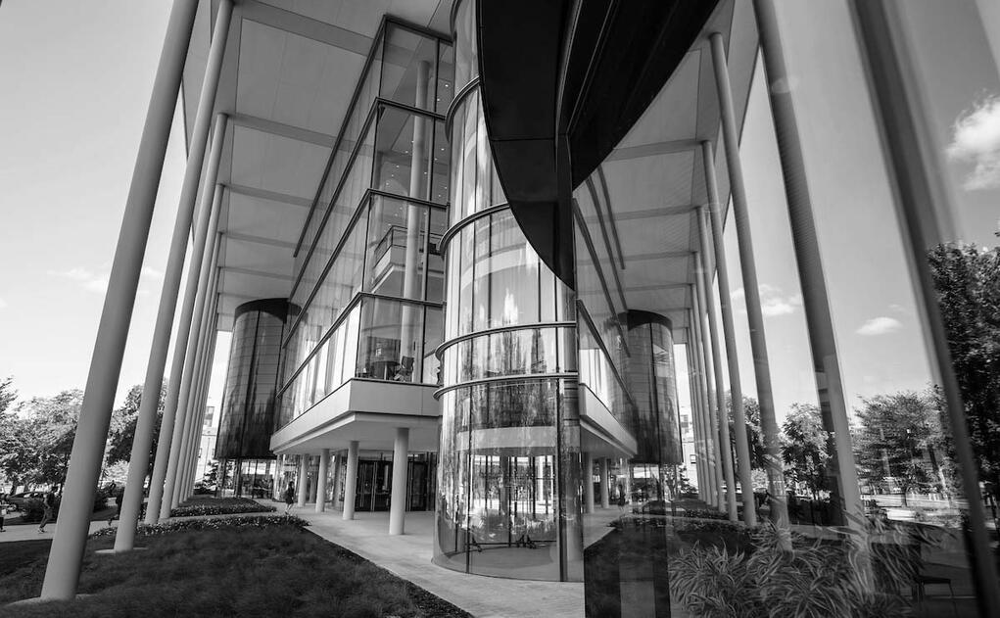

Edward H. Kaplan


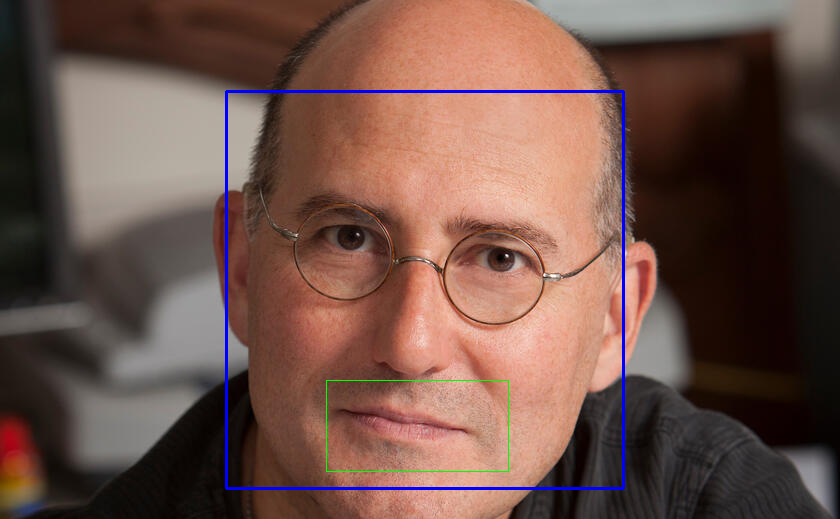

Ivana V. Katic


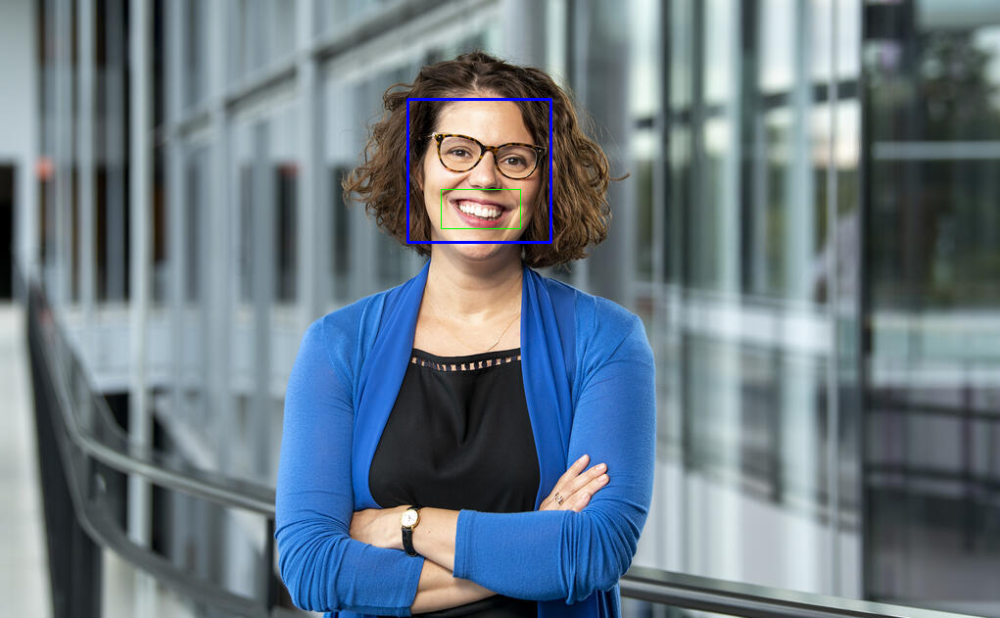

Bryan T. Kelly


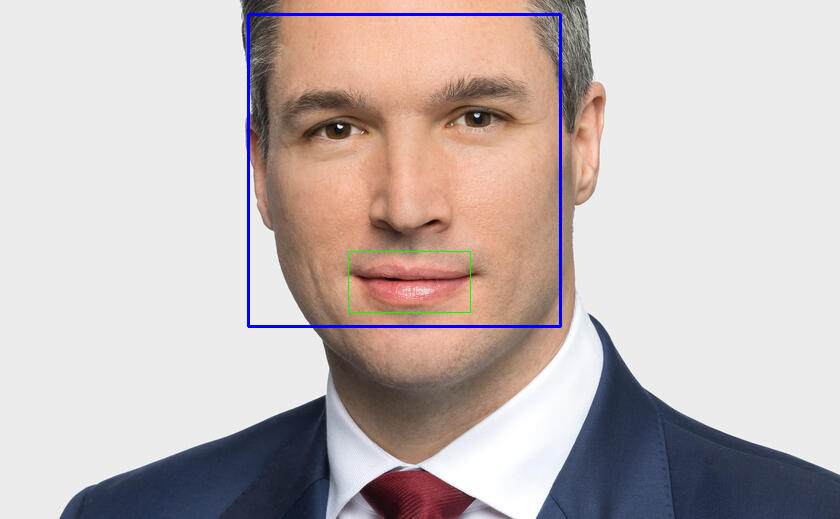

Sang Kim


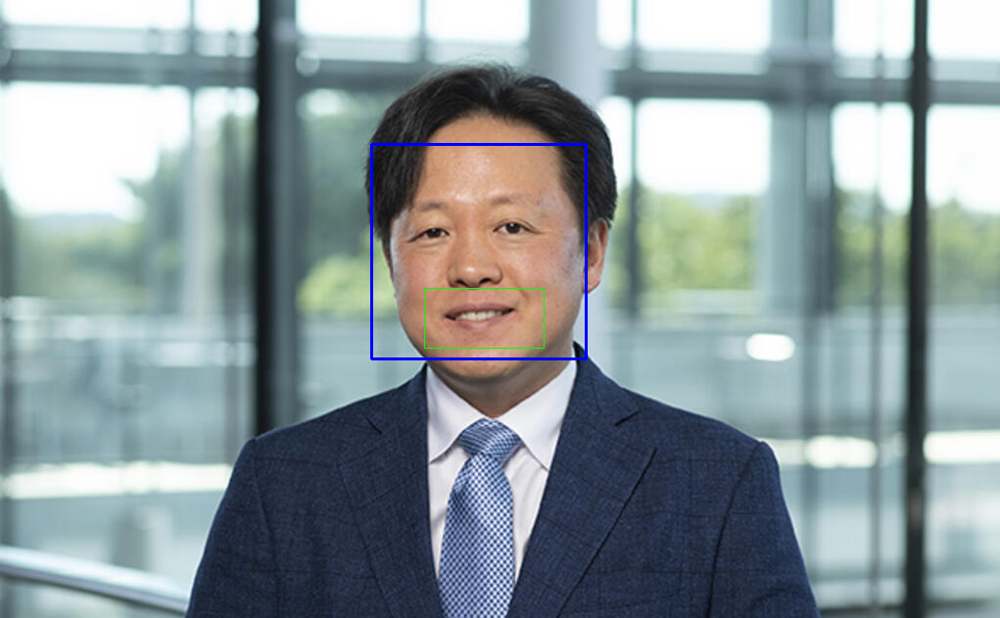

Joowon Klusowski


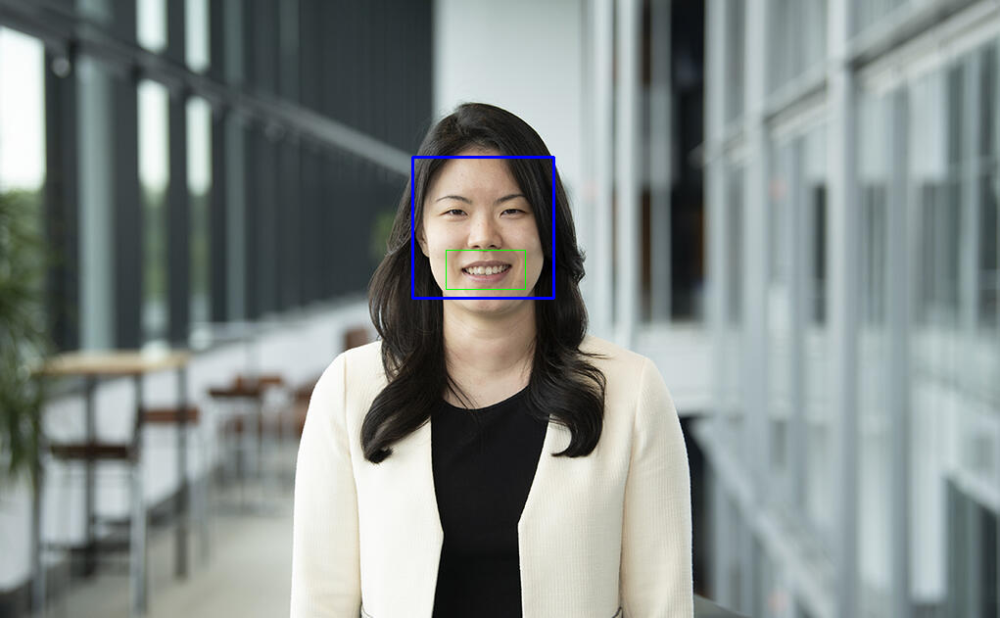

Balázs Kovács


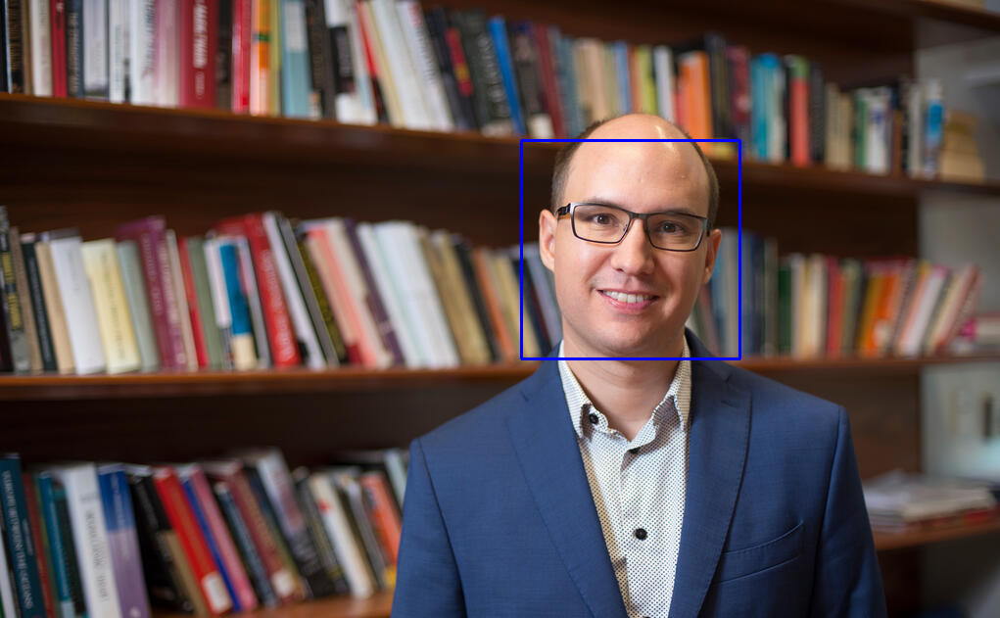

Vineet Kumar


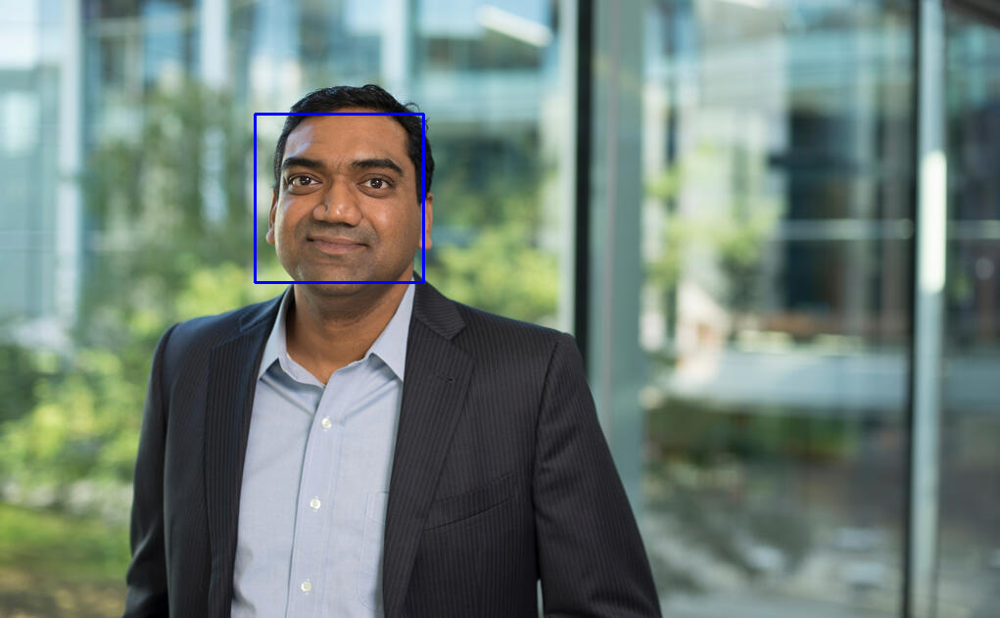

Cameron LaPoint


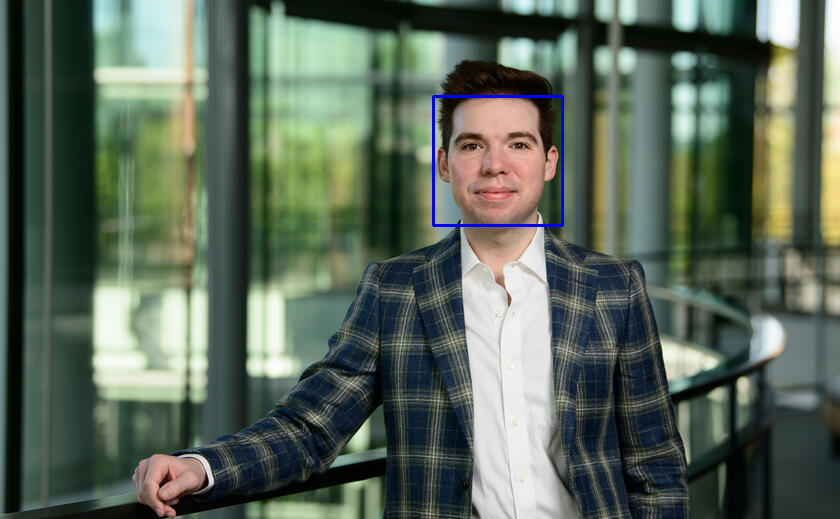

James A. Levinsohn


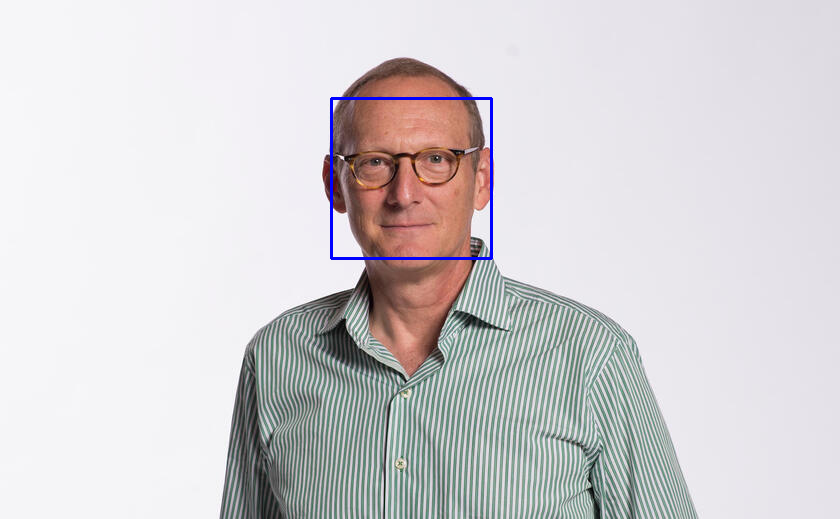

Zhen Lian


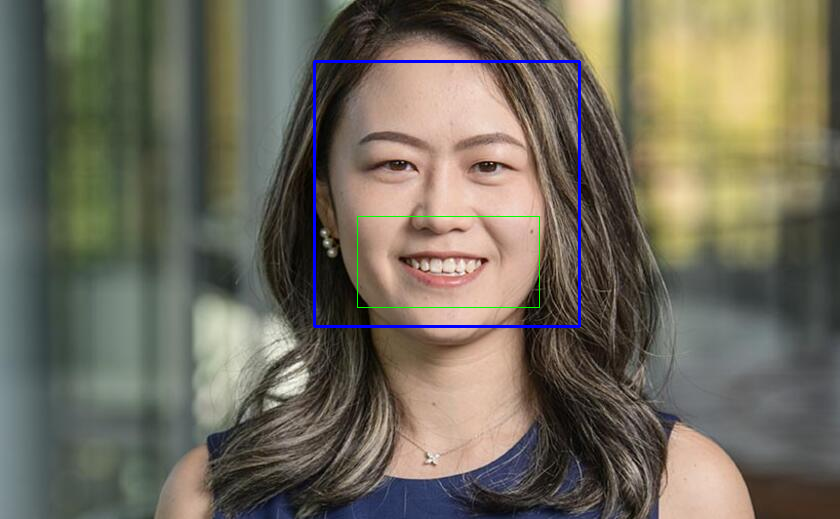

Song Ma


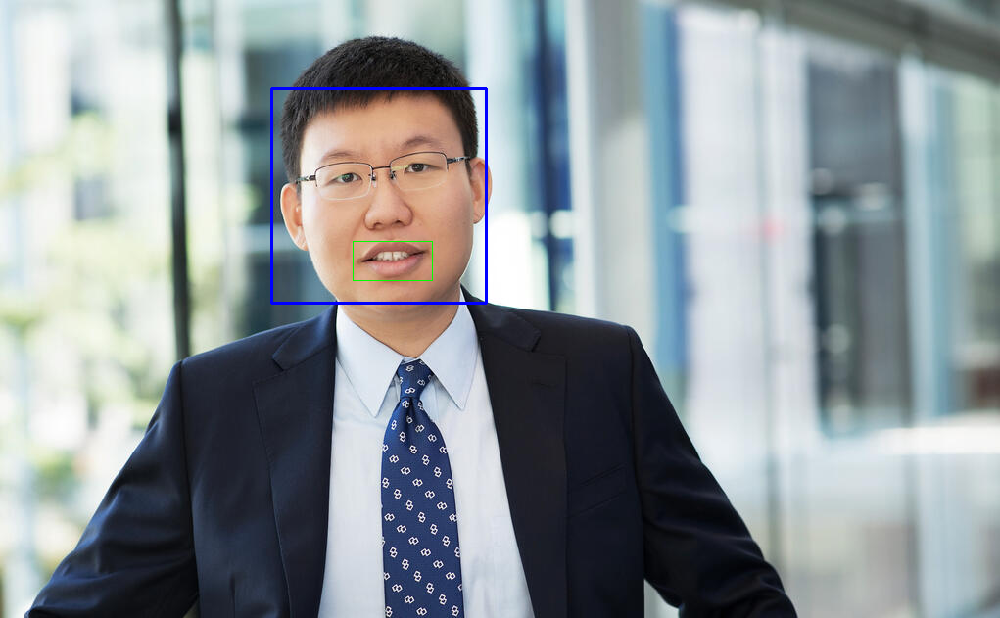

Vahideh Manshadi


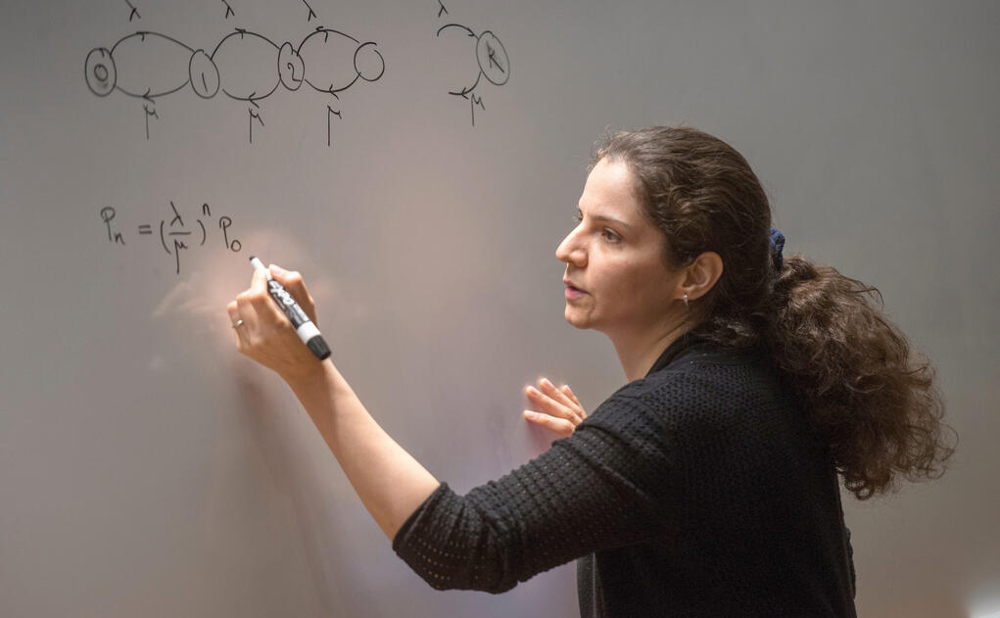

Lesley Meng


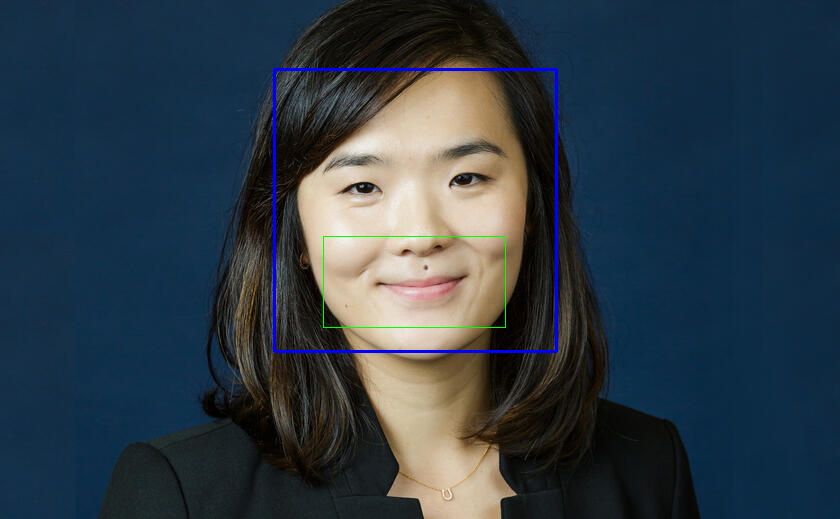

Andrew Metrick


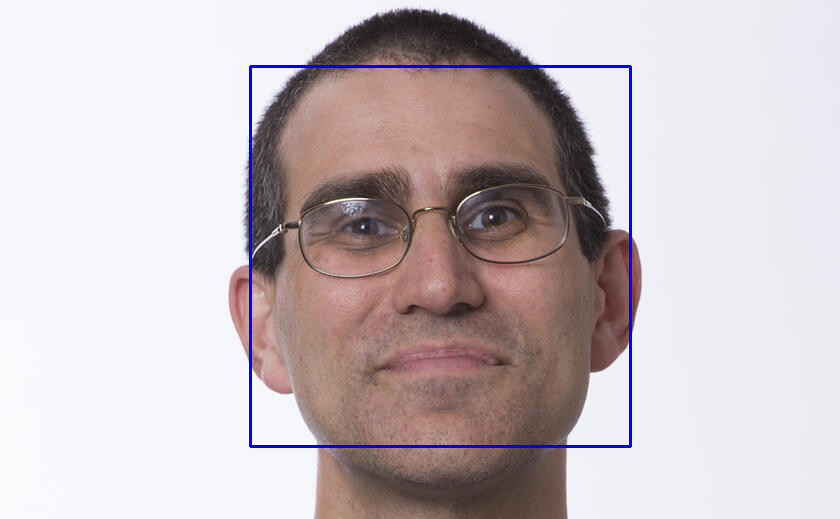

Ahmed Mushfiq Mobarak


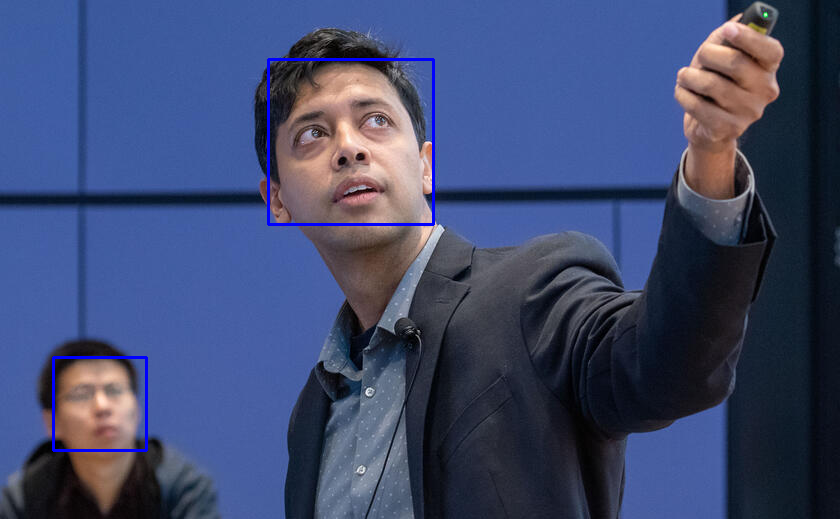

Faidra Monachou


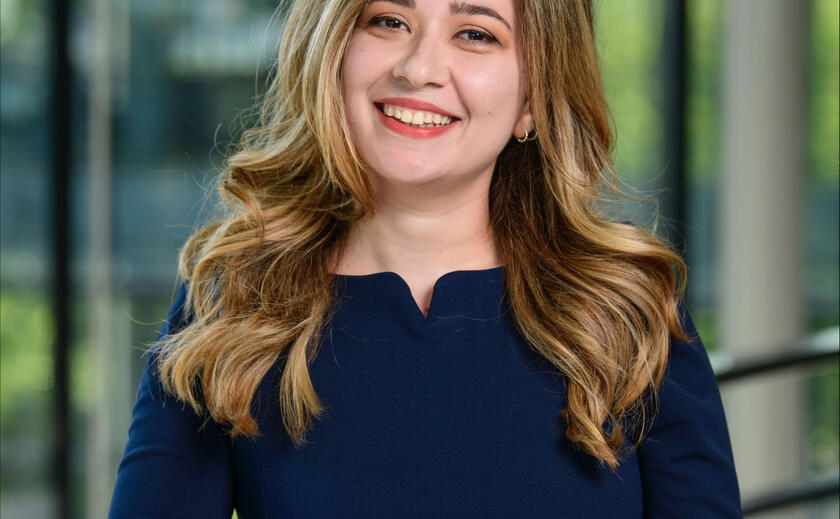

Tobias J. Moskowitz


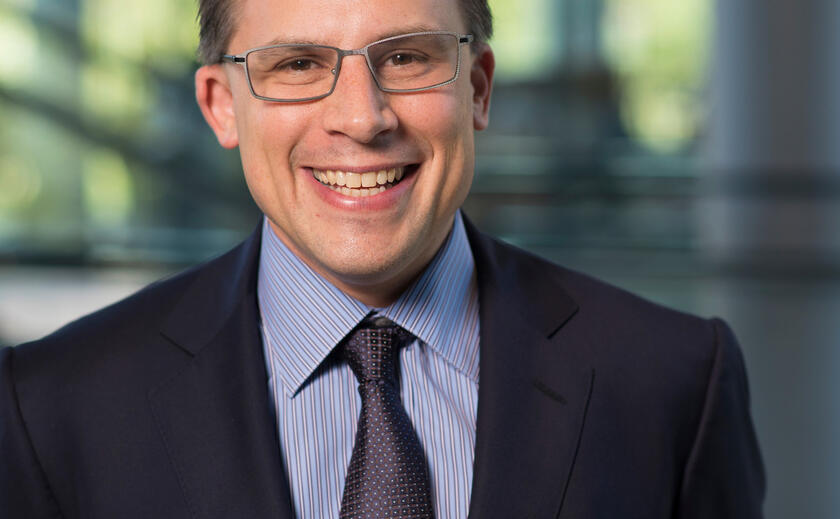

David M. Munguia Gomez


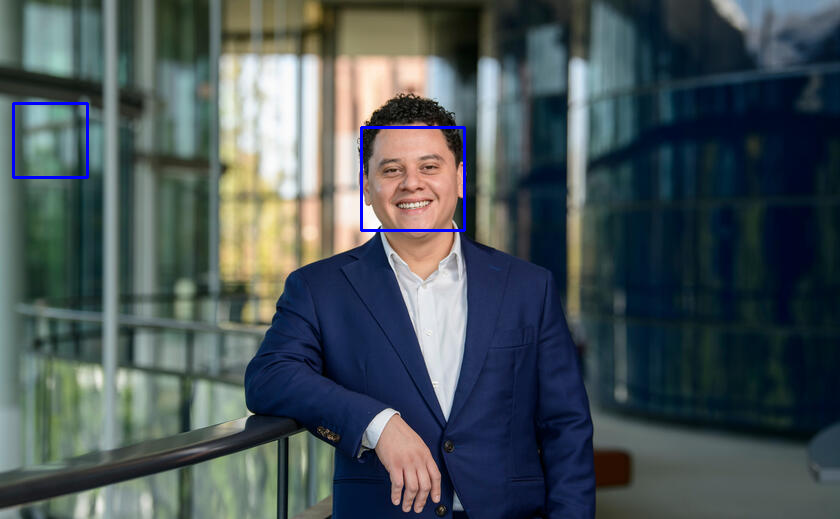

Anya Nakhmurina


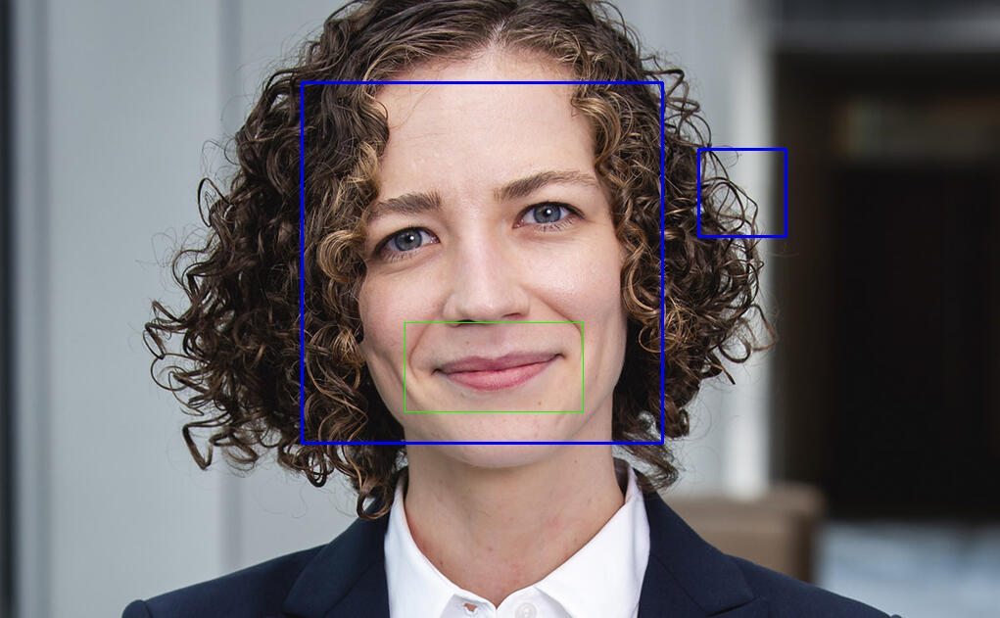

Barry Nalebuff


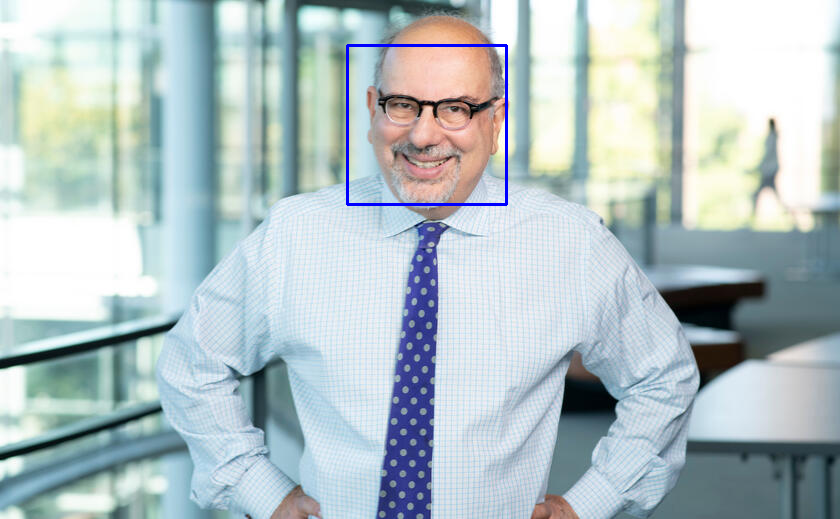

Nathan Novemsky


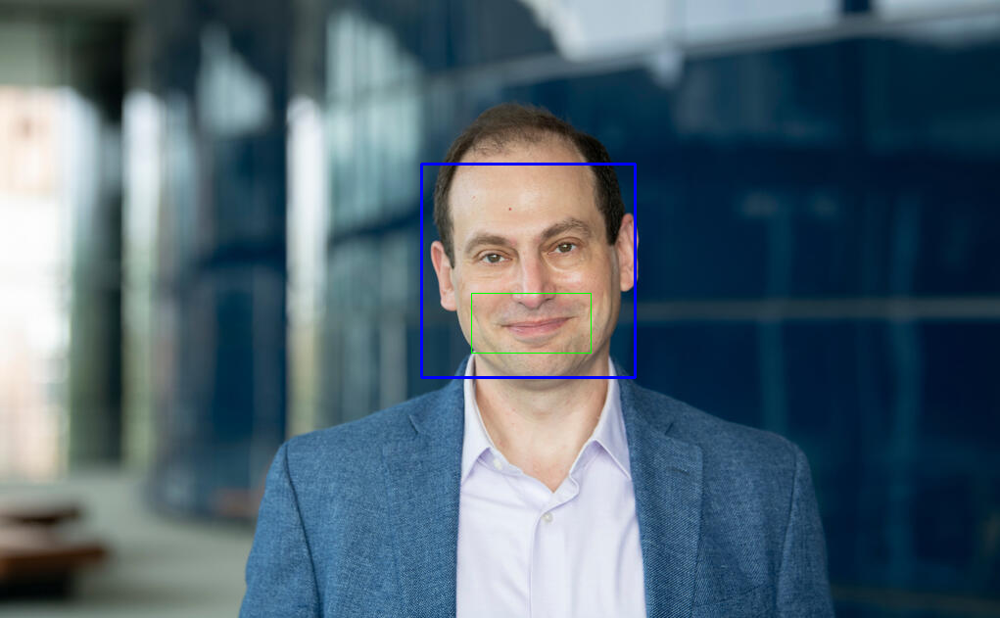

Jayanti Owens


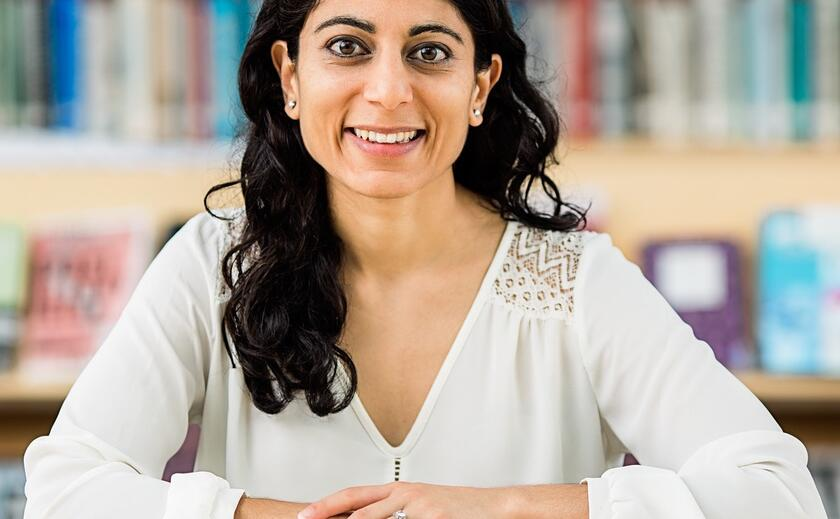

Edieal J. Pinker


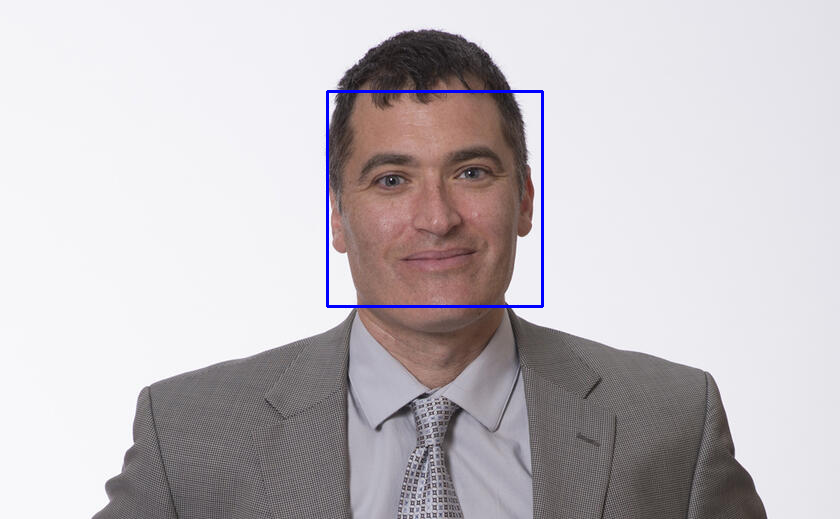

Benjamin Polak


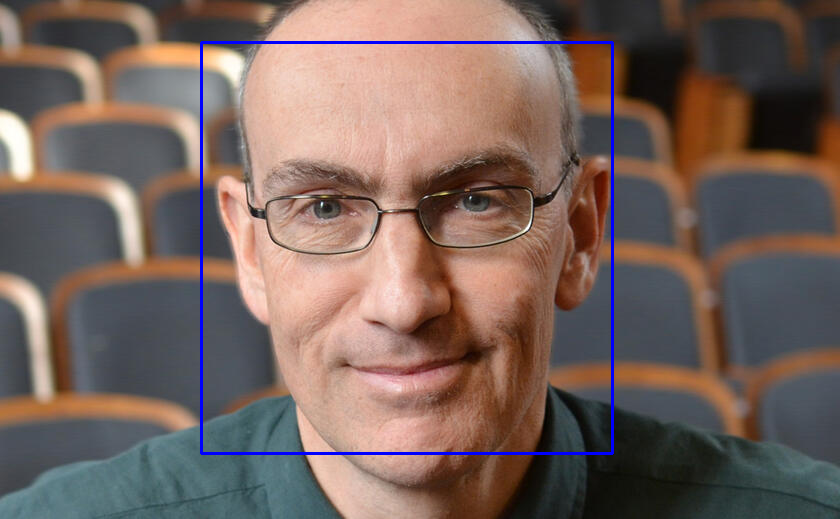

Taly Reich


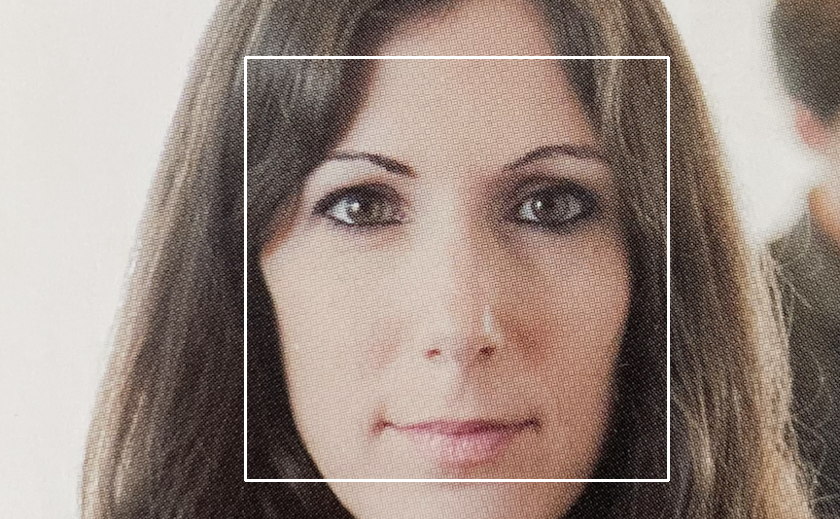

K. Geert Rouwenhorst


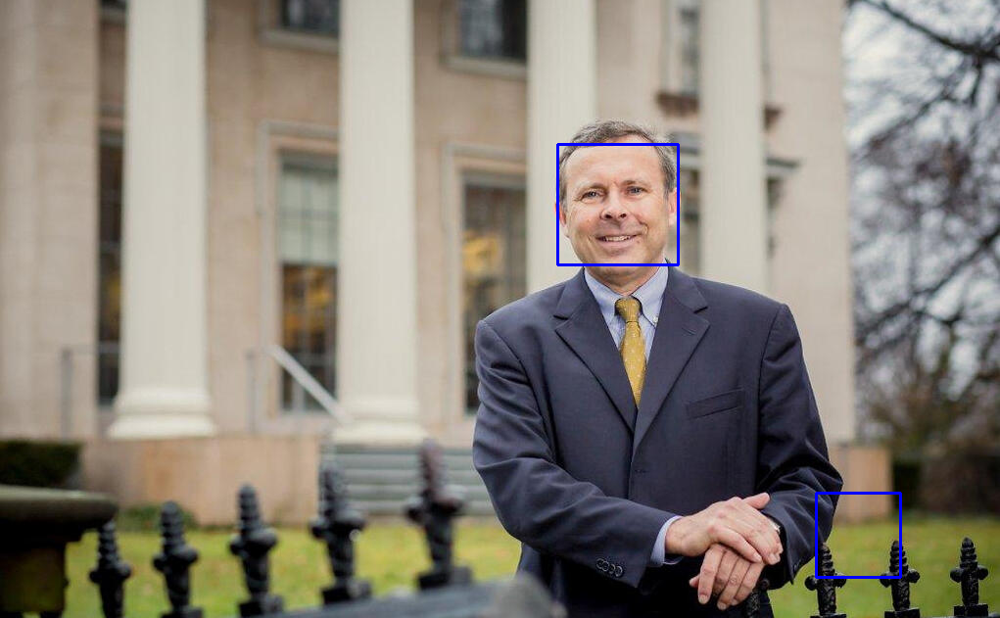

Nils Rudi


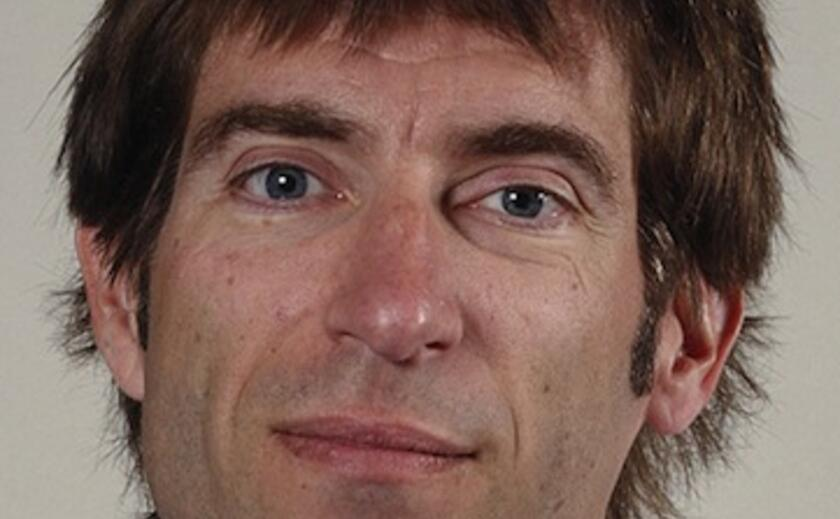

Peter K. Schott


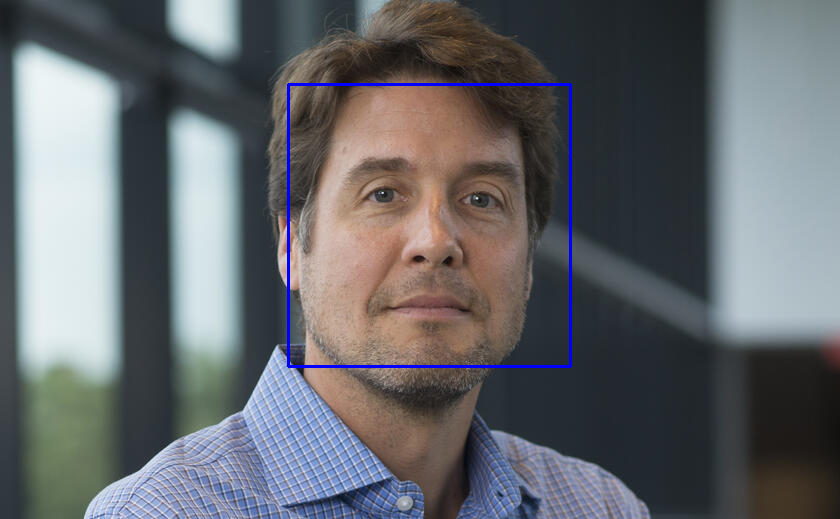

Fiona M. Scott Morton


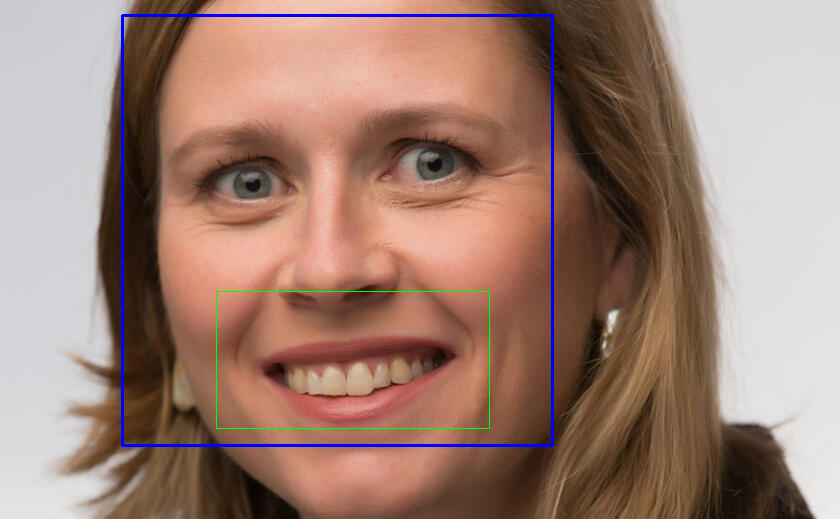

Katja Seim


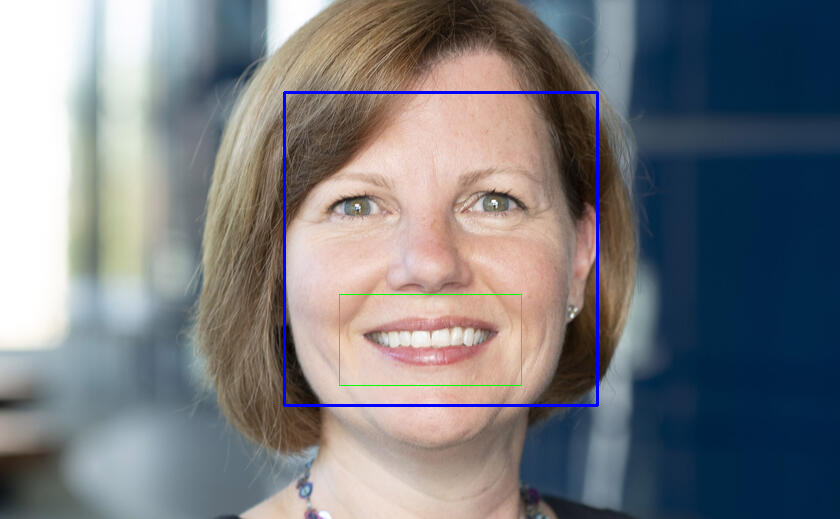

Jiwoong Shin


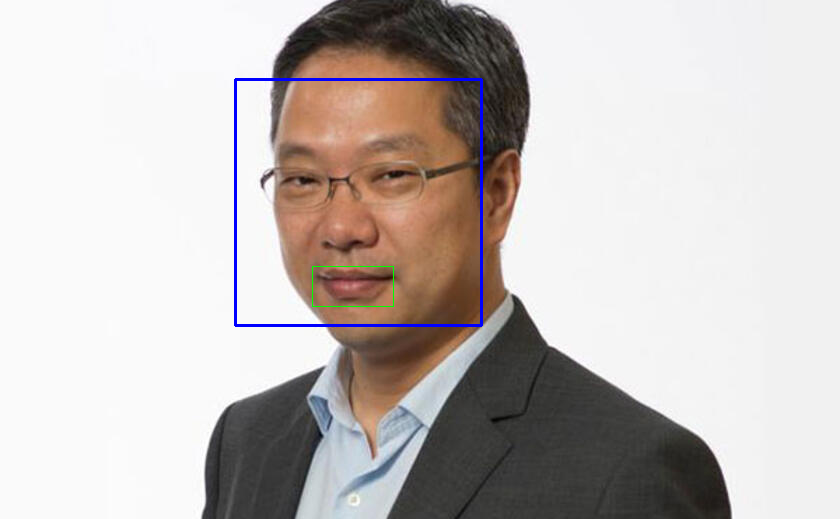

Kelly Shue


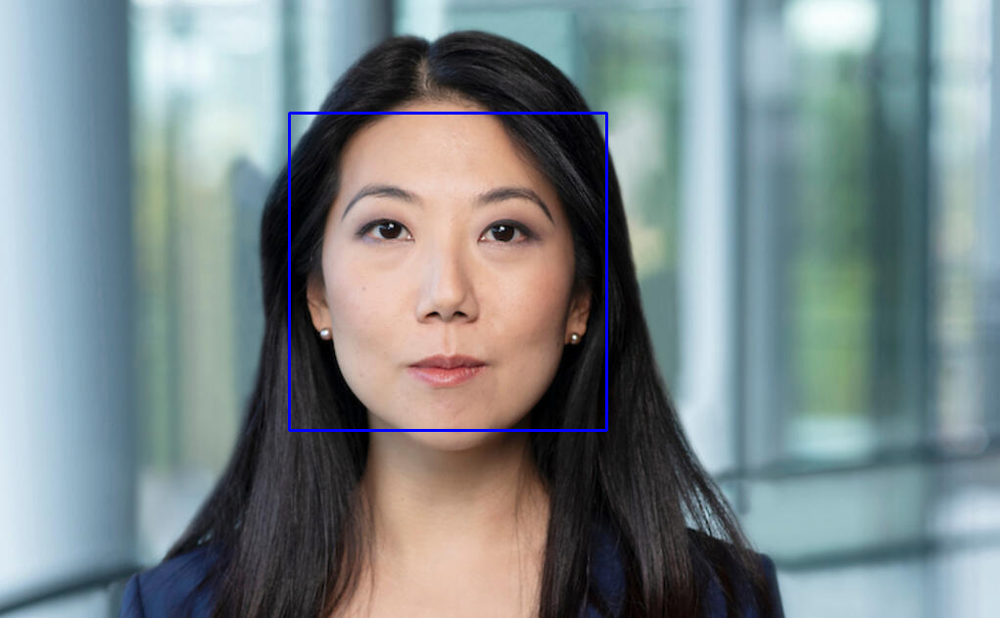

Alp Simsek


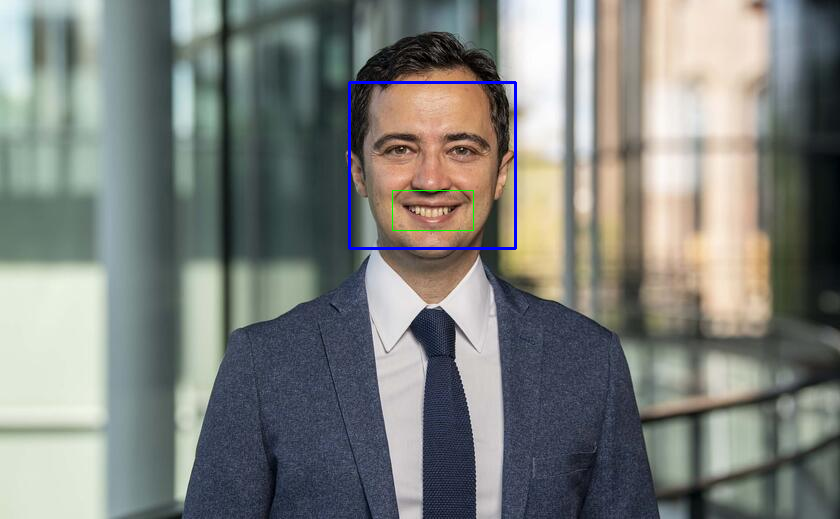

Michael Sinkinson


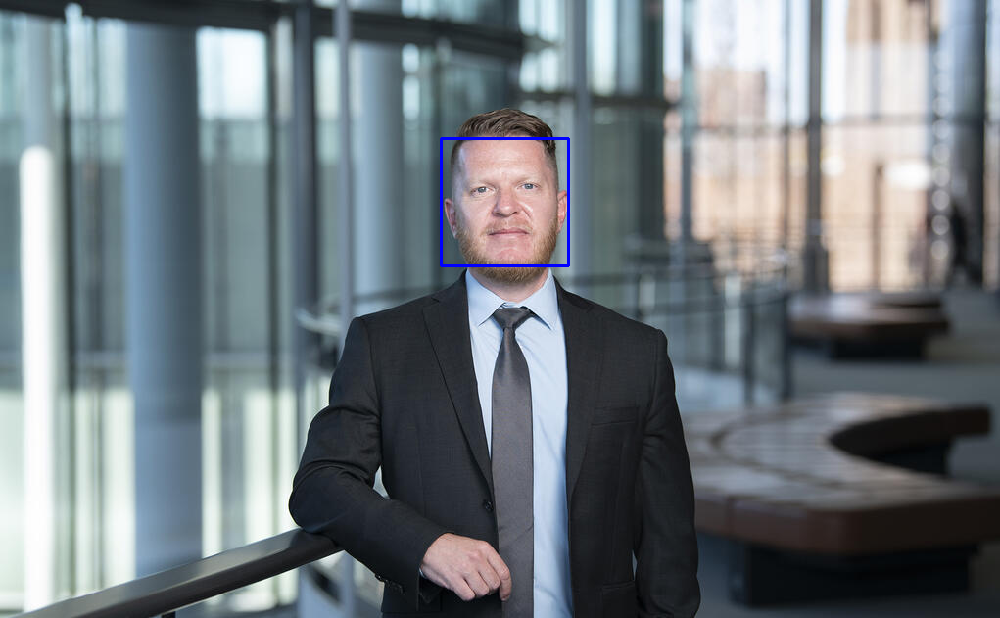

Deborah Small


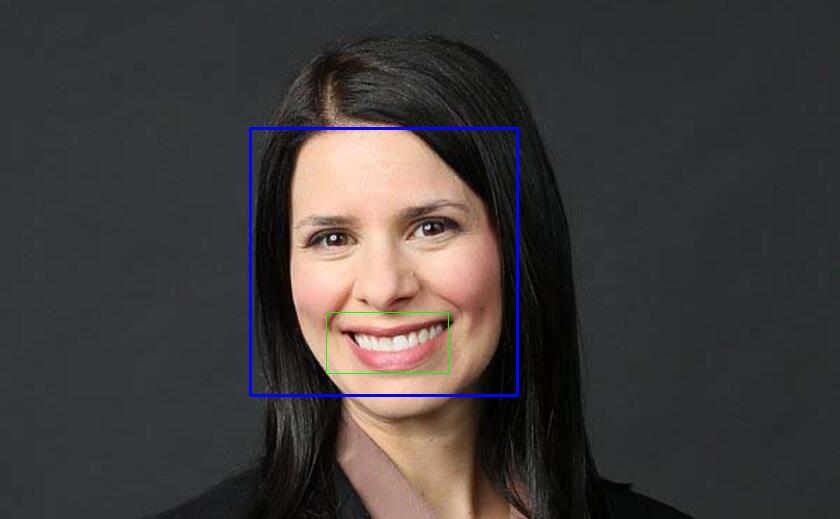

Edward A. Snyder


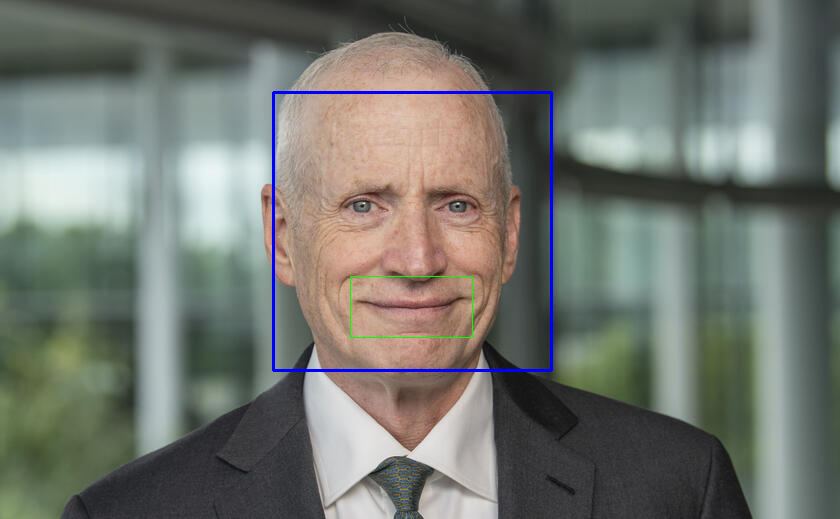

Matthew Spiegel


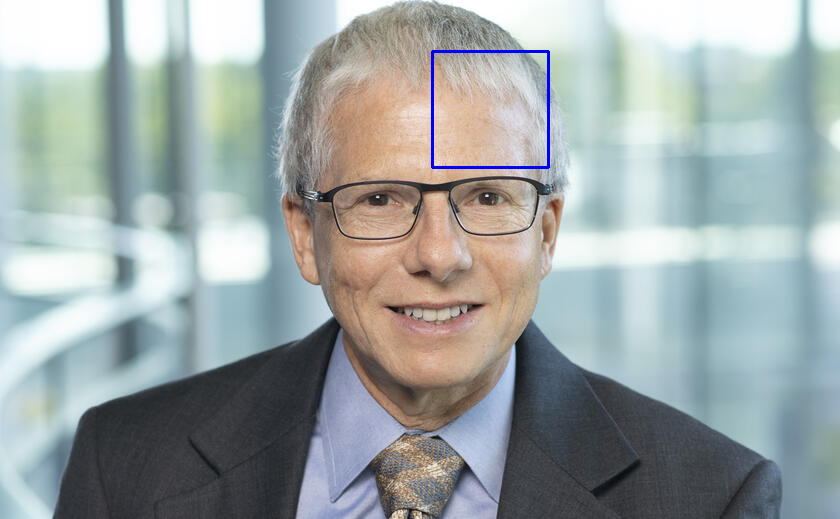

Thomas Steffen


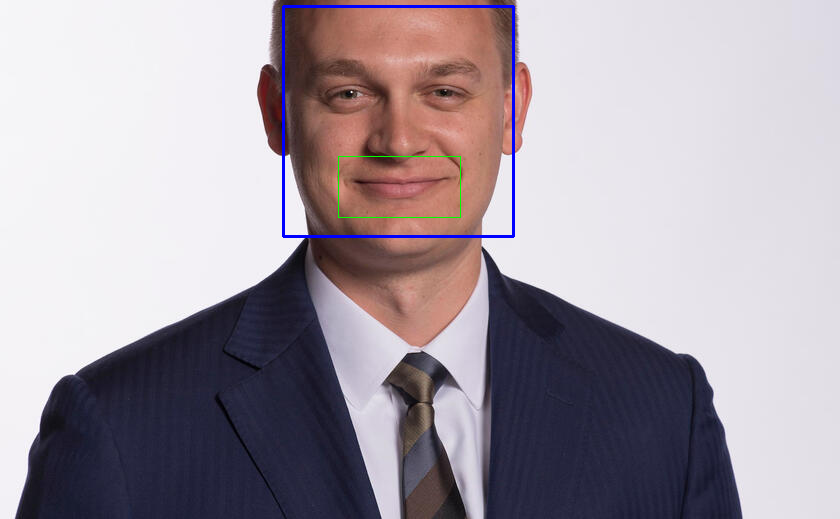

K. Sudhir


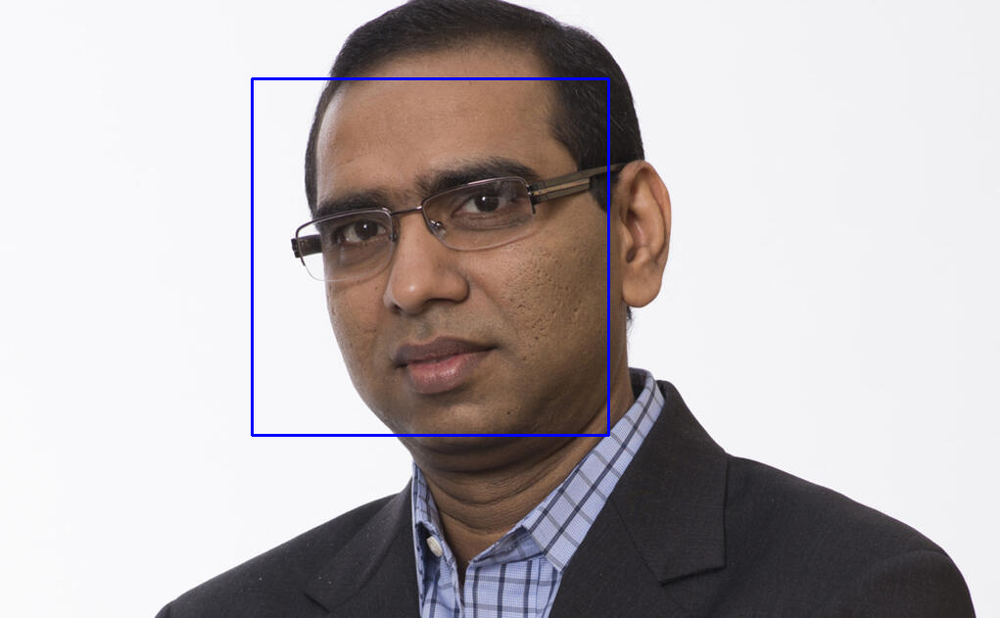

Jacob Thomas


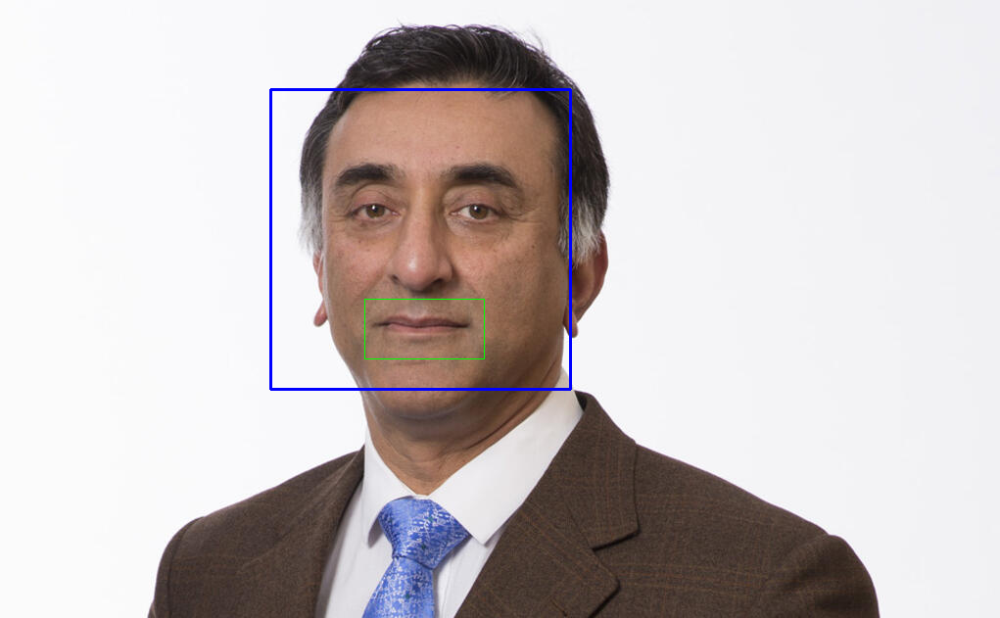

Heather E. Tookes


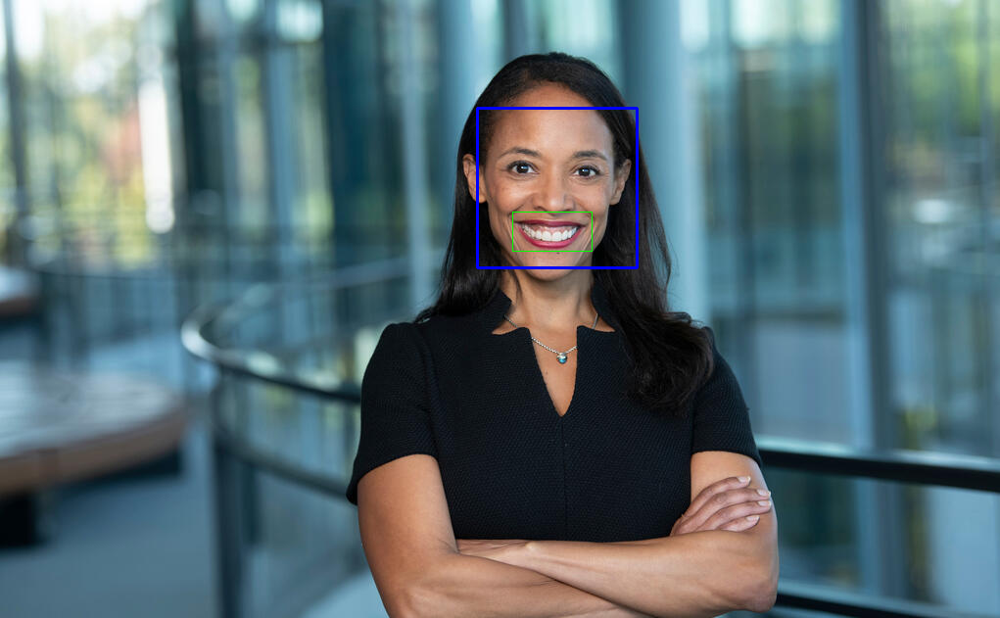

Kosuke Uetake


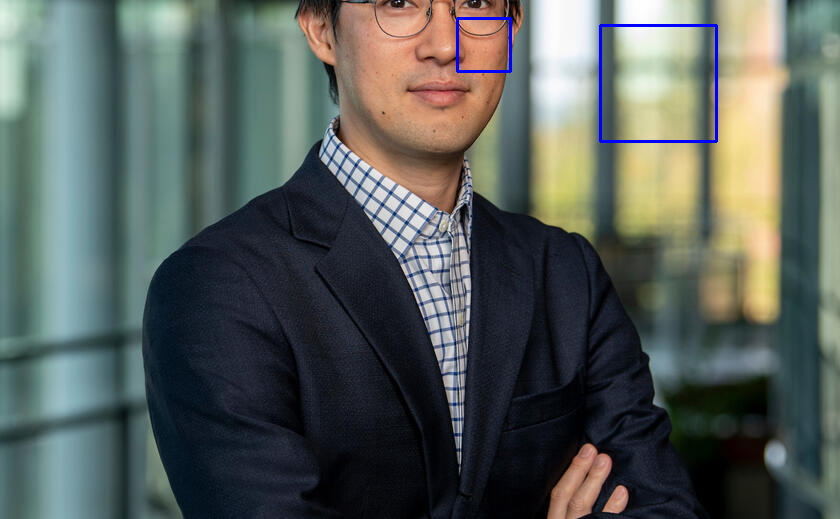

Diana Van Patten


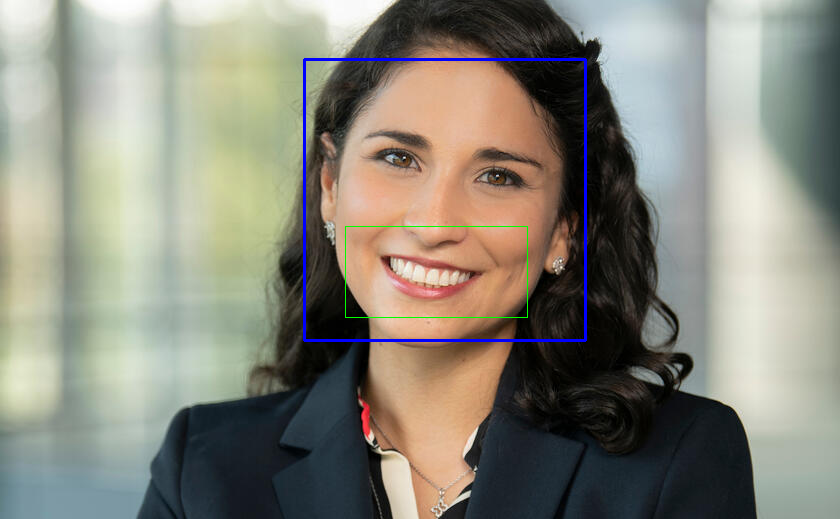

Tong Wang


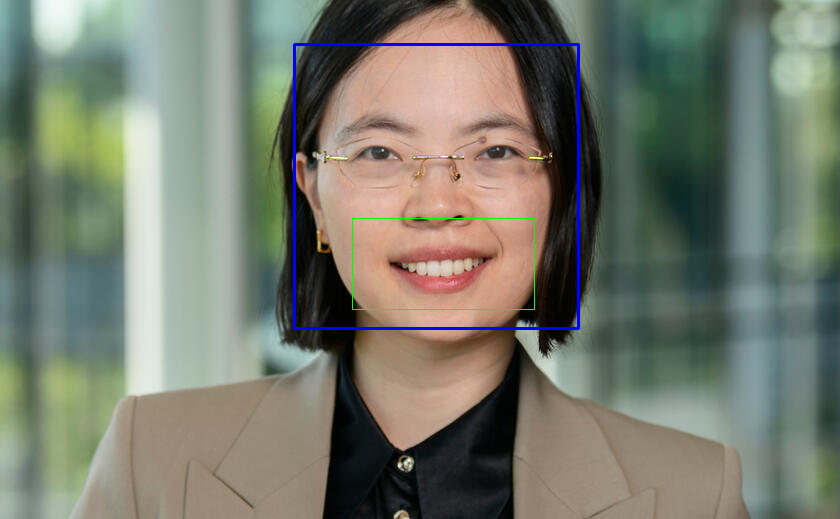

Edward Watts


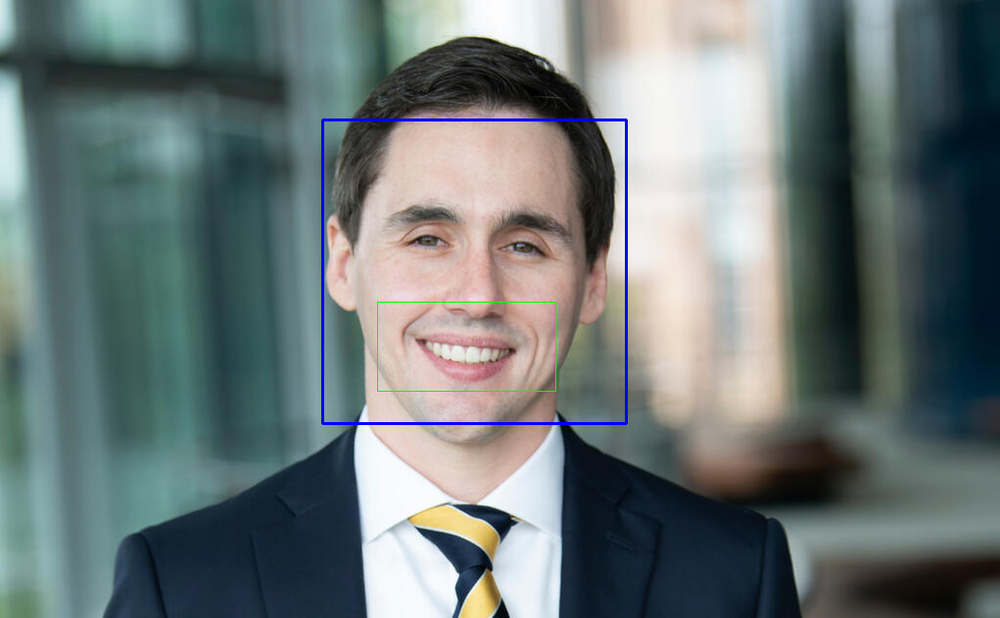

Kevin R. Williams


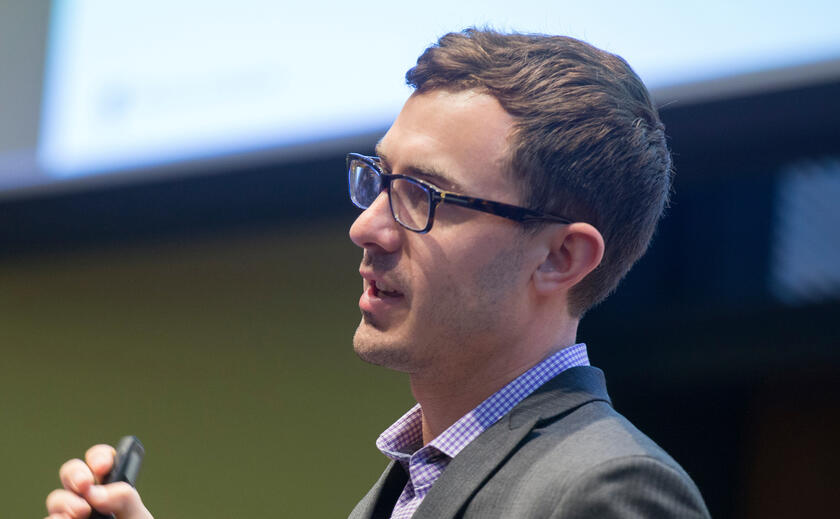

Kai Hao Yang


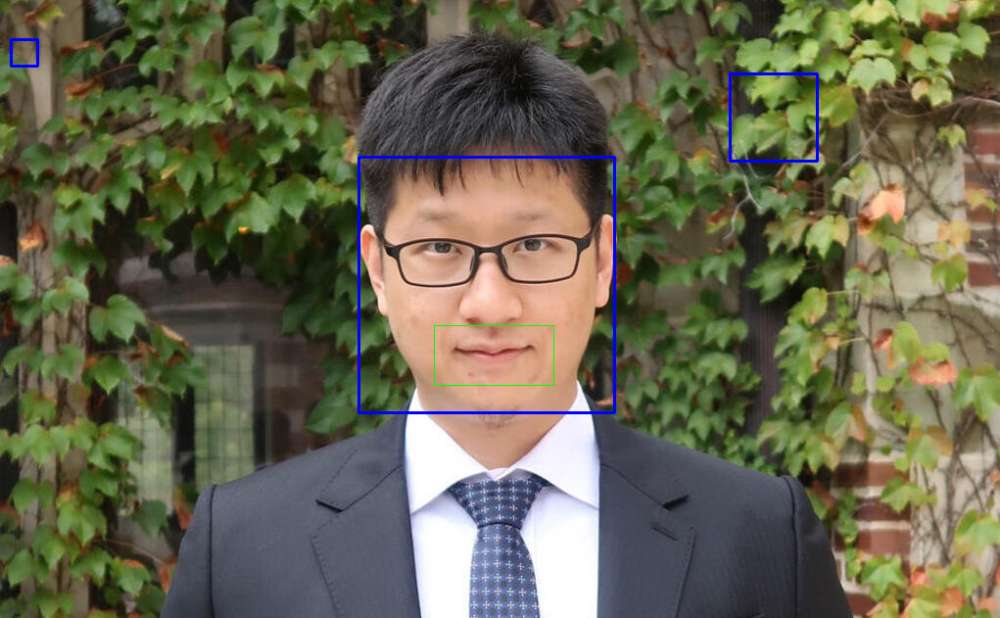

Tauhid Zaman


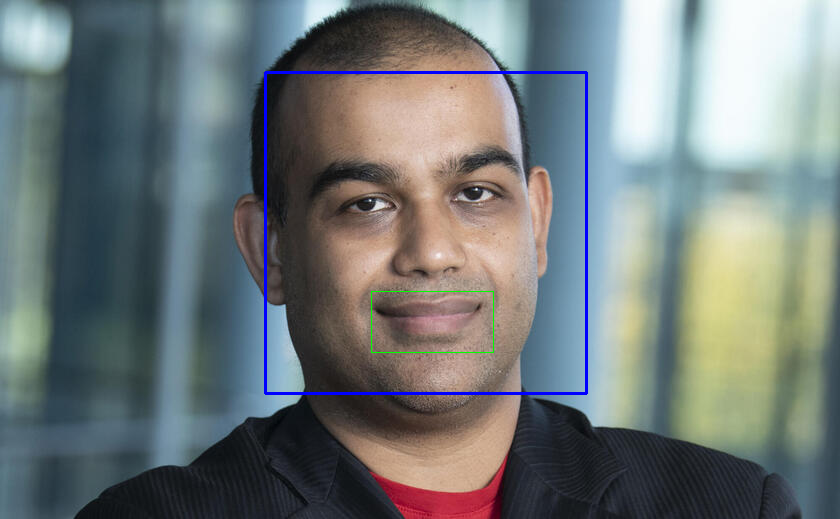

Gal Zauberman


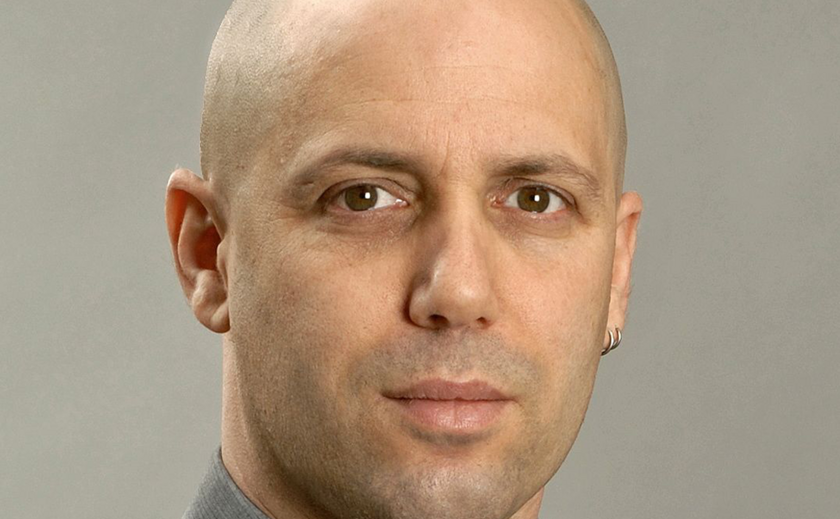

Alexander Zentefis


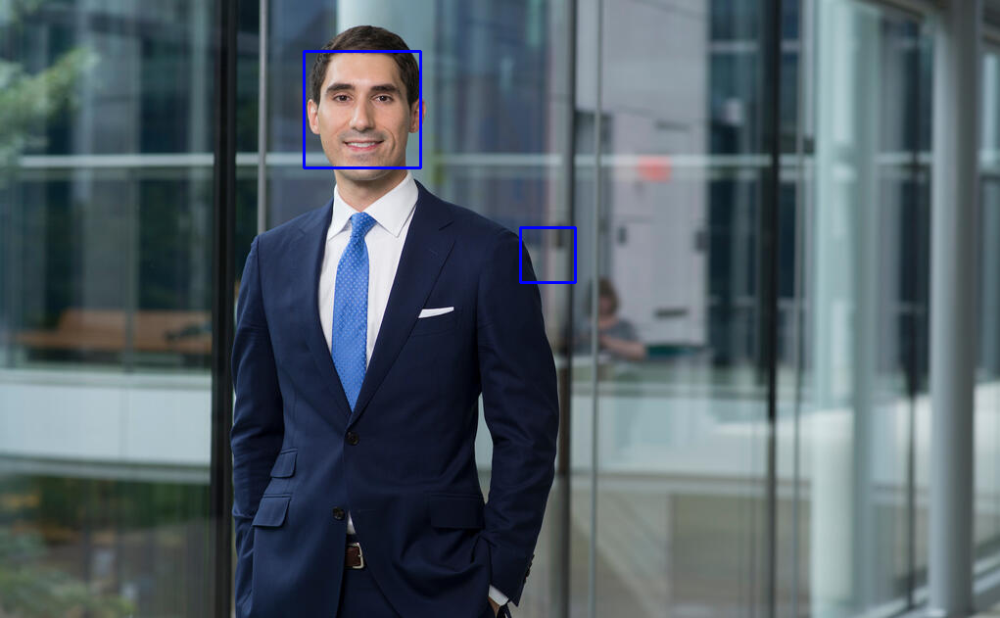

X. Frank Zhang


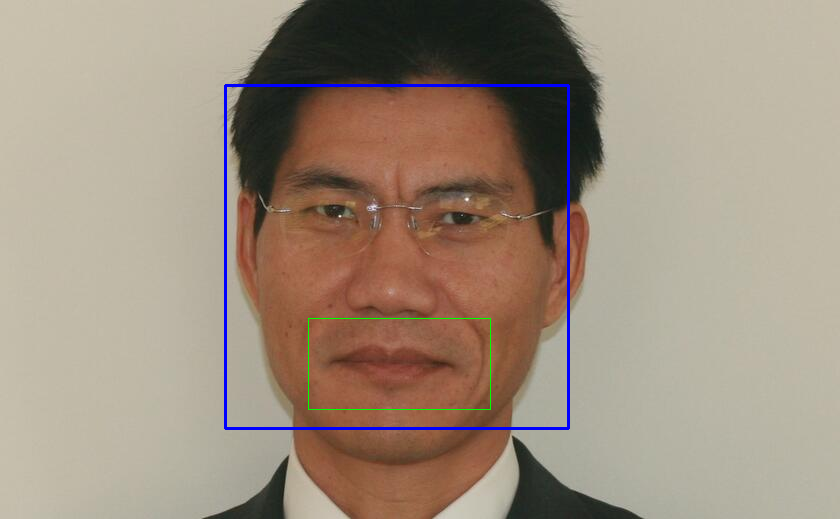

Jidong Zhou


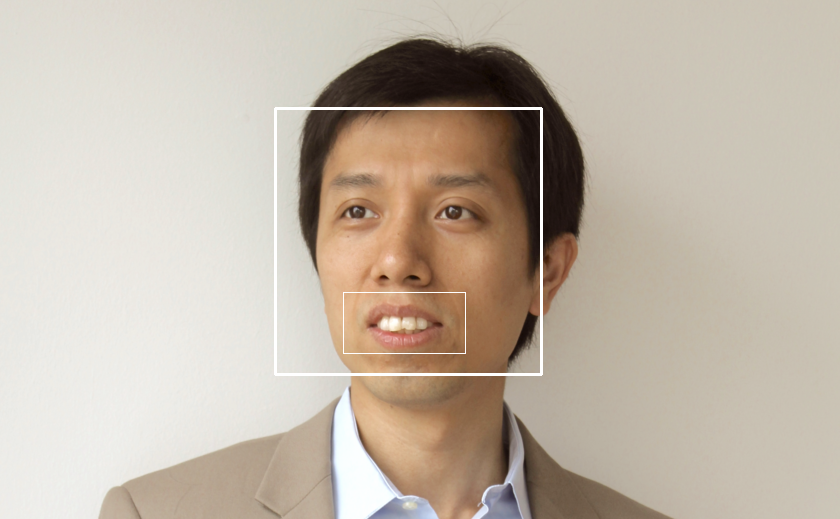

Seth Zimmerman


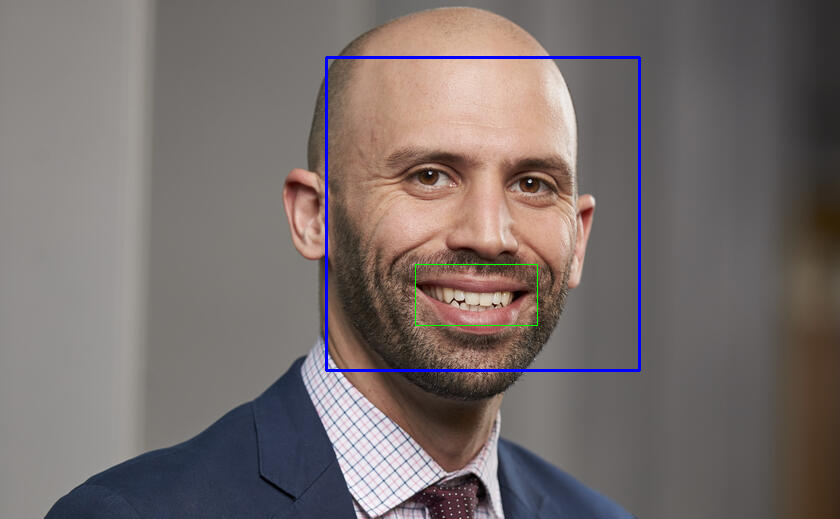

In [165]:
import cv2
from google.colab.patches import cv2_imshow

face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')
smile_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_smile.xml')

names = []
face_detected = []
smile_detected = []

for index, row in df_SOM_prof.iterrows():
    name = row["Name"]
    new_name = name.lower().replace(".", "").replace(" ", "_")
    filename = f"{new_name}.jpg"

    img = cv2.imread(f'/content/{filename}', -1)

    faces = face_cascade.detectMultiScale(img, scaleFactor=1.3, minNeighbors=4)

    if len(faces) > 0:
        face_var = 1
    else:
        face_var = 0

    for (x, y, w, h) in faces:
        # Draw rectangle around face
        cv2.rectangle(img, (x, y), (x + w, y + h), (255, 0, 0), 2)
        roi_bottom_half = img[y + int(h * 0.5):y + h, x:x + w]

        # Check if the region of interest is not None
        if roi_bottom_half is not None:
            smiles = smile_cascade.detectMultiScale(roi_bottom_half, scaleFactor=1.5, minNeighbors=40)

            if len(smiles) > 0:
                smile_var = 1
            else:
                smile_var = 0

            smile_coordinates = [(x + sx, y + int(h * 0.5) + sy, sw, sh) for (sx, sy, sw, sh) in smiles]
            # Calculate the bounding box for all smiles
            if smile_coordinates:
                min_x = min([x for (x, y, w, h) in smile_coordinates])
                min_y = min([y for (x, y, w, h) in smile_coordinates])
                max_w = max([x + w for (x, y, w, h) in smile_coordinates]) - min_x
                max_h = max([y + h for (x, y, w, h) in smile_coordinates]) - min_y

                # Draw a single larger rectangle around all smiles
                cv2.rectangle(img, (min_x, min_y), (min_x + max_w, min_y + max_h), (0, 255, 0), 1)

    face_detected.append(face_var)
    smile_detected.append(smile_var)
    names.append(name)


    print(name)
    cv2_imshow(img)
    cv2.waitKey(0)
    cv2.destroyAllWindows()
# Zeqiong Huang; Matthew Spiegel; Kosuke Uetake



In [166]:
df_smile = pd.DataFrame({"Name":names,
                         "Face":face_detected,
                         "Smile":smile_detected
                         })

df_smile.head()

# Wrong Face Detection
# # Zeqiong Huang; Matthew Spiegel; Kosuke Uetake


df_smile.loc[df_smile["Name"] == "Zeqiong Huang", "Face"] = 0
df_smile.loc[df_smile["Name"] == "Matthew Spiegel", "Face"] = 0
df_smile.loc[df_smile["Name"] == "Kosuke Uetake", "Face"] = 0

# Merge the Dataset

In [167]:
df_result = df_SOM_prof.merge(df_smile, on="Name")

df_result["University"] = "Yale"

df_result = df_result[["University","Name","Department","Rank","Sex","Title","Pronouns","URL","Face","Smile"]]

In [168]:
df_result.to_csv("Yale_meta_smile.csv", index=False)

In [169]:
df_result["Face"].value_counts()

1    74
0    13
Name: Face, dtype: int64

In [170]:
df_result["Smile"].value_counts()

1    53
0    34
Name: Smile, dtype: int64

# Statistical Test

In [171]:
df = df_result

df = df[df["Face"] == 1]

df = df[df["Sex"] != "Unknown"]

df = df[df["Rank"] != "Emeritus"]


In [172]:
df.head()

,University,Name,Department,Rank,Sex,Title,Pronouns,URL,Face,Smile
0,Yale,Jason Abaluck,Economics,Full,Male,Professor of Economics,[his],https://som.yale.edu/faculty-research/faculty-...,1,0
1,Yale,Laura Adler,Organizational Behavior,Assistant,Female,Assistant Professor of Organizational Behavior,"[her, she]",https://som.yale.edu/faculty-research/faculty-...,1,1
2,Yale,Rick Antle,Accounting,Full,Male,William S. Beinecke Professor of Accounting,"[he, his, his, he, his, he, his]",https://som.yale.edu/faculty-research/faculty-...,1,1
3,Yale,David Argente,Economics,Assistant,Male,Assistant Professor of Economics,"[he, his]",https://som.yale.edu/faculty-research/faculty-...,1,1
4,Yale,Nicholas C. Barberis,Finance,Full,Male,Stephen and Camille Schramm Professor of Finance,"[he, his]",https://som.yale.edu/faculty-research/faculty-...,1,1


In [173]:
from scipy.stats import chi2_contingency

contingency_table = pd.crosstab(df['Sex'], df['Smile'])
print(contingency_table, "\n")

chi2, p, dof, expected = chi2_contingency(contingency_table)

print(f"Chi-square statistic: {chi2}")
print(f"P-value: {p}")
print(f"Degrees of freedom: {dof}")
print("Expected frequencies:")
print(expected)

Smile    0   1
Sex           
Female   4  15
Male    23  31 

Chi-square statistic: 1.9500540300025417
P-value: 0.16258102859828988
Degrees of freedom: 1
Expected frequencies:
[[ 7.02739726 11.97260274]
 [19.97260274 34.02739726]]


In [174]:
from scipy.stats import chi2_contingency

contingency_table = pd.crosstab(df['Rank'], df['Smile'])
print(contingency_table, "\n")

chi2, p, dof, expected = chi2_contingency(contingency_table)

print(f"Chi-square statistic: {chi2}")
print(f"P-value: {p}")
print(f"Degrees of freedom: {dof}")
print("Expected frequencies:")
print(expected)

Smile       0   1
Rank             
Assistant   8  18
Associate   4   5
Full       15  23 

Chi-square statistic: 0.7468645032209742
P-value: 0.6883676205143108
Degrees of freedom: 2
Expected frequencies:
[[ 9.61643836 16.38356164]
 [ 3.32876712  5.67123288]
 [14.05479452 23.94520548]]


In [175]:
from scipy.stats import chi2_contingency

contingency_table = pd.crosstab([df['Rank'], df["Sex"]], df['Smile'])
print(contingency_table, "\n")

chi2, p, dof, expected = chi2_contingency(contingency_table)

print(f"Chi-square statistic: {chi2}")
print(f"P-value: {p}")
print(f"Degrees of freedom: {dof}")
print("Expected frequencies:")
print(expected)

Smile              0   1
Rank      Sex           
Assistant Female   2   9
          Male     6   9
Associate Female   1   0
          Male     3   5
Full      Female   1   6
          Male    14  17 

Chi-square statistic: 5.868648272277304
P-value: 0.31921059399246704
Degrees of freedom: 5
Expected frequencies:
[[ 4.06849315  6.93150685]
 [ 5.54794521  9.45205479]
 [ 0.36986301  0.63013699]
 [ 2.95890411  5.04109589]
 [ 2.5890411   4.4109589 ]
 [11.46575342 19.53424658]]
